In [1]:
import torch
import json
import h5py
import random
import numpy as np
from matplotlib.pyplot import imshow
from PIL import Image, ImageDraw
import csv
import pandas as pd


In [2]:
# load the following to files from DETECTED_SGG_DIR
custom_prediction = json.load(open('X:/99_exchange/Du/SG_test_data/hallway_sg_pred/custom_prediction.json'))
custom_data_info = json.load(open('X:/99_exchange/Du/SG_test_data/hallway_sg_pred/custom_data_info.json'))

In [96]:
custom_prediction

{'idx_to_files': ['C:/Projekte/01_resources/sgg/pano/00143-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00134-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00135-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00142-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00141-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00139-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00136-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00137-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00138-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00133-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00140-pano.jpg',
  'C:/Projekte/01_resources/sgg/pano/00144-pano.jpg'],
 'ind_to_classes': ['__background__',
  'airplane',
  'animal',
  'arm',
  'bag',
  'banana',
  'basket',
  'beach',
  'bear',
  'bed',
  'bench',
  'bike',
  'bird',
  'board',
  'boat',
  'book',
  'boot',
  'bottle',
  'bowl',
  'box',
  'boy',
  'branch',
  'building',
  'bus',
  'cabinet',
  'cap',
  'car',
  'cat',
  'chair',
 

In [19]:
def draw_single_box(pic, box, color='red', draw_info=None):
    draw = ImageDraw.Draw(pic)
    x1,y1,x2,y2 = int(box[0]), int(box[1]), int(box[2]), int(box[3])
    draw.rectangle(((x1, y1), (x2, y2)), outline=color)
    if draw_info:
        draw.rectangle(((x1, y1), (x1+50, y1+10)), fill=color)
        info = draw_info
        draw.text((x1, y1), info)
        
def print_list(name, input_list, scores=None):
    for i, item in enumerate(input_list):
        if scores == None:
            print(name + ' ' + str(i) + ': ' + str(item))
        else:
            print(name + ' ' + str(i) + ': ' + str(item) + '; score: ' + str(scores[i]))
    
def draw_image(img_path, boxes, box_labels, rel_labels, box_scores=None, rel_scores=None, save=False):
    size = get_size(Image.open(img_path).size)
    pic = Image.open(img_path).resize(size)
    num_obj = len(boxes)
    for i in range(num_obj):
        info = str(i) + '_' + box_labels[i]
        draw_single_box(pic, boxes[i], draw_info=info)
    if save:
        filename = img_path.split("/")[-1]
        list_filename = img_path.split("/")[-1].split(".")[0]+".csv"
        sg_folder_name = "/".join(img_path.split("/")[0:-2])+"/hallway_sg_pred/" 
        image_name = sg_folder_name + filename
        pic.save(image_name)       
        merged_results = box_labels + rel_scores
        with open(sg_folder_name+list_filename, 'w') as f:
            # using csv.writer method from CSV package
            write = csv.writer(f)
            write.writerow(merged_results)
        frame = pd.DataFrame(
            {'box_labels': box_labels + rel_labels,
             'box_scores': box_scores +rel_scores
            })
        frame.to_csv(sg_folder_name+list_filename)
    display(pic)
    print('*' * 50)
    print_list('box_labels', box_labels, box_scores)
    print('*' * 50)
    print_list('rel_labels', rel_labels, rel_scores)
    
    return None

def get_size(image_size):
    min_size = 600
    max_size = 1000
    w, h = image_size
    size = min_size
    if max_size is not None:
        min_original_size = float(min((w, h)))
        max_original_size = float(max((w, h)))
        if max_original_size / min_original_size * size > max_size:
            size = int(round(max_size * min_original_size / max_original_size))
    if (w <= h and w == size) or (h <= w and h == size):
        return (w, h)
    if w < h:
        ow = size
        oh = int(size * h / w)
    else:
        oh = size
        ow = int(size * w / h)
    return (ow, oh)

def filter_predictions(prediction_scores, bounding_boxes, labels):
    filtered_prediction_scores = []
    filtered_bounding_boxes = []
    filtered_labels = []

    for score, box, label in zip(prediction_scores, bounding_boxes, labels):
        if score > 0.7:
            filtered_prediction_scores.append(score)
            filtered_bounding_boxes.append(box)
            filtered_labels.append(label)

    return filtered_prediction_scores, filtered_bounding_boxes, filtered_labels

In [20]:
# parameters

box_topk = 8 # select top k bounding boxes
rel_topk = 10 # select top k relationships
ind_to_classes = custom_data_info['ind_to_classes']
ind_to_predicates = custom_data_info['ind_to_predicates']

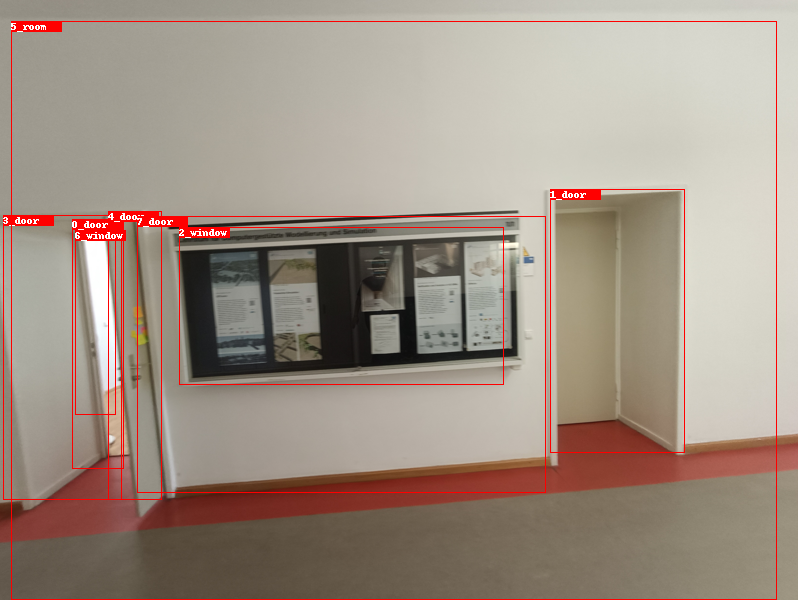

**************************************************
box_labels 0: door; score: 0.3661310076713562
box_labels 1: door; score: 0.34031999111175537
box_labels 2: window; score: 0.33227935433387756
box_labels 3: door; score: 0.28495922684669495
box_labels 4: door; score: 0.25257980823516846
box_labels 5: room; score: 0.2190738469362259
box_labels 6: window; score: 0.11203625053167343
box_labels 7: door; score: 0.09095781296491623
**************************************************
rel_labels 0: 5_room => has => 0_door; score: 0.8560233116149902
rel_labels 1: 5_room => has => 3_door; score: 0.8402561545372009
rel_labels 2: 5_room => has => 1_door; score: 0.8168320655822754
rel_labels 3: 5_room => has => 4_door; score: 0.7983652353286743
rel_labels 4: 5_room => has => 6_window; score: 0.7836387753486633
rel_labels 5: 0_door => in => 5_room; score: 0.7522367238998413
rel_labels 6: 6_window => in => 5_room; score: 0.7377352714538574
rel_labels 7: 3_door => in => 5_room; score: 0.7341774702072144

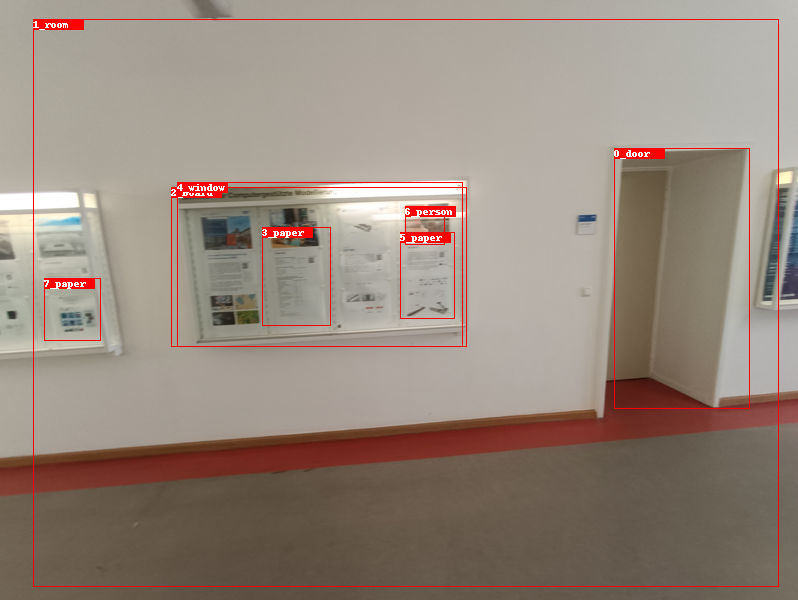

**************************************************
box_labels 0: door; score: 0.42958134412765503
box_labels 1: room; score: 0.2648373246192932
box_labels 2: board; score: 0.15205739438533783
box_labels 3: paper; score: 0.07474964112043381
box_labels 4: window; score: 0.0652608871459961
box_labels 5: paper; score: 0.059616830199956894
box_labels 6: person; score: 0.04944011941552162
box_labels 7: paper; score: 0.041663289070129395
**************************************************
rel_labels 0: 1_room => has => 0_door; score: 0.8090165853500366
rel_labels 1: 1_room => has => 4_window; score: 0.6604825854301453
rel_labels 2: 0_door => in => 1_room; score: 0.6387680172920227
rel_labels 3: 2_board => in => 1_room; score: 0.6278595328330994
rel_labels 4: 1_room => has => 7_paper; score: 0.6259745359420776
rel_labels 5: 1_room => has => 5_paper; score: 0.6173421740531921
rel_labels 6: 1_room => has => 2_board; score: 0.5774093270301819
rel_labels 7: 4_window => in => 1_room; score: 0.486330

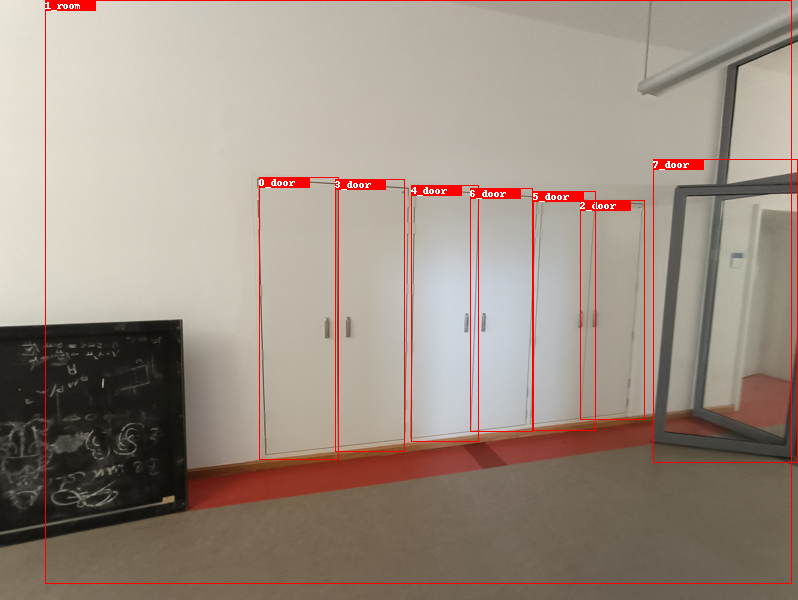

**************************************************
box_labels 0: door; score: 0.564041793346405
box_labels 1: room; score: 0.4122920632362366
box_labels 2: door; score: 0.36887145042419434
box_labels 3: door; score: 0.35931292176246643
box_labels 4: door; score: 0.28204524517059326
box_labels 5: door; score: 0.22658531367778778
box_labels 6: door; score: 0.18329674005508423
box_labels 7: door; score: 0.1489497423171997
**************************************************
rel_labels 0: 1_room => has => 2_door; score: 0.8914708495140076
rel_labels 1: 1_room => has => 5_door; score: 0.8673639297485352
rel_labels 2: 1_room => has => 6_door; score: 0.8464503884315491
rel_labels 3: 1_room => has => 0_door; score: 0.8345159888267517
rel_labels 4: 1_room => has => 3_door; score: 0.8190224170684814
rel_labels 5: 1_room => has => 4_door; score: 0.8043068051338196
rel_labels 6: 7_door => in => 1_room; score: 0.606023371219635
rel_labels 7: 4_door => in => 1_room; score: 0.5534578561782837
rel_label

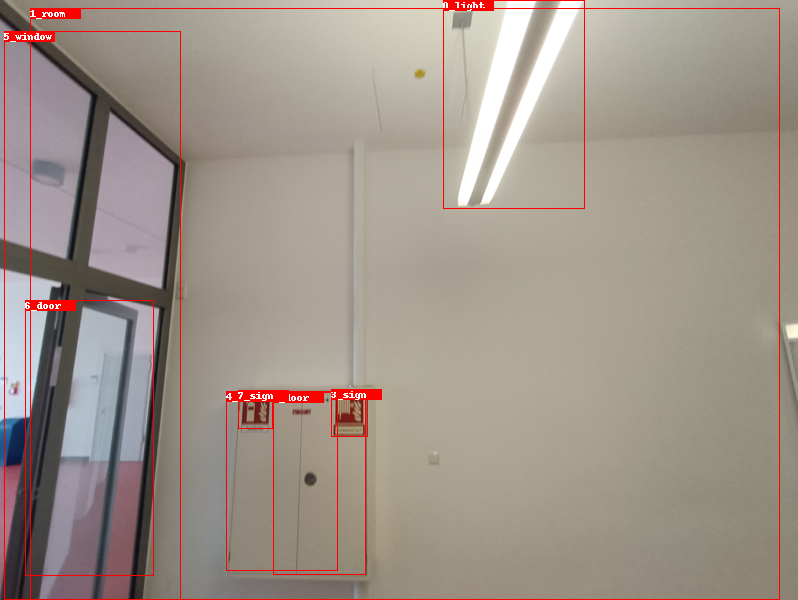

**************************************************
box_labels 0: light; score: 0.7716960906982422
box_labels 1: room; score: 0.4557165801525116
box_labels 2: door; score: 0.3798273801803589
box_labels 3: sign; score: 0.35585886240005493
box_labels 4: door; score: 0.2637079060077667
box_labels 5: window; score: 0.20470033586025238
box_labels 6: door; score: 0.16737303137779236
box_labels 7: sign; score: 0.15271632373332977
**************************************************
rel_labels 0: 1_room => has => 2_door; score: 0.9389333724975586
rel_labels 1: 1_room => has => 4_door; score: 0.9270763993263245
rel_labels 2: 1_room => has => 6_door; score: 0.8611404895782471
rel_labels 3: 1_room => has => 0_light; score: 0.762959361076355
rel_labels 4: 5_window => has => 2_door; score: 0.7373236417770386
rel_labels 5: 7_sign => under => 0_light; score: 0.705902099609375
rel_labels 6: 1_room => has => 3_sign; score: 0.6768883466720581
rel_labels 7: 3_sign => under => 0_light; score: 0.6735110282897

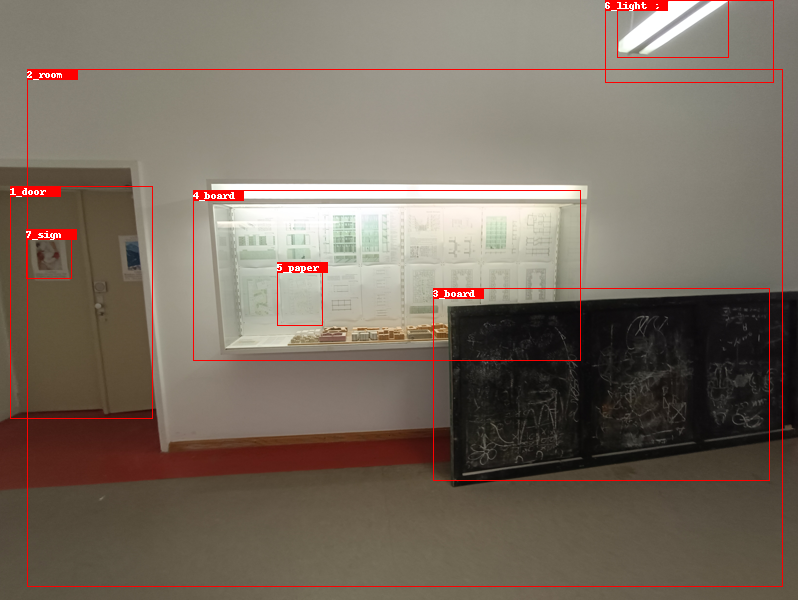

**************************************************
box_labels 0: light; score: 0.7036838531494141
box_labels 1: door; score: 0.5772870779037476
box_labels 2: room; score: 0.26486700773239136
box_labels 3: board; score: 0.21766039729118347
box_labels 4: board; score: 0.14047718048095703
box_labels 5: paper; score: 0.053280651569366455
box_labels 6: light; score: 0.04381444305181503
box_labels 7: sign; score: 0.04344796761870384
**************************************************
rel_labels 0: 2_room => has => 1_door; score: 0.8720148205757141
rel_labels 1: 3_board => under => 0_light; score: 0.77591872215271
rel_labels 2: 0_light => above => 3_board; score: 0.754183828830719
rel_labels 3: 3_board => in => 2_room; score: 0.7453885674476624
rel_labels 4: 4_board => in => 2_room; score: 0.672404408454895
rel_labels 5: 0_light => above => 4_board; score: 0.6594564318656921
rel_labels 6: 2_room => has => 6_light; score: 0.6312497854232788
rel_labels 7: 2_room => has => 7_sign; score: 0.626491

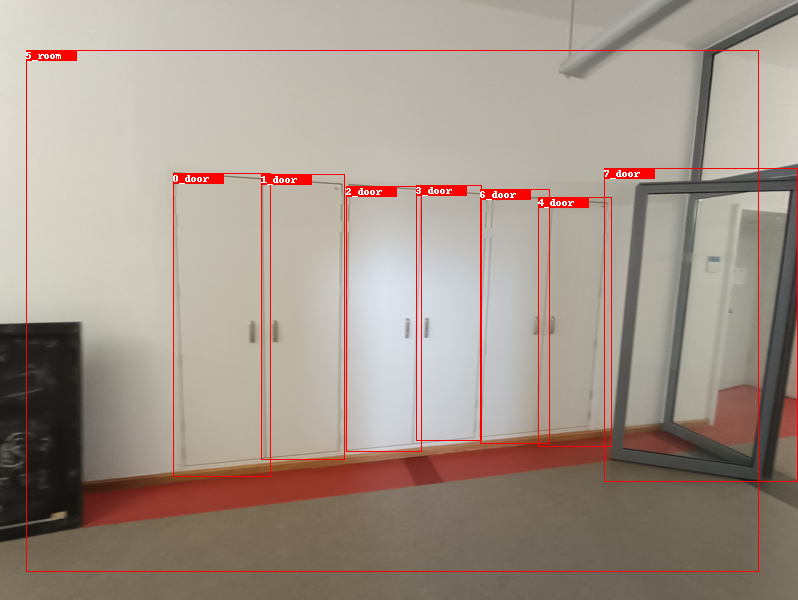

**************************************************
box_labels 0: door; score: 0.5020657181739807
box_labels 1: door; score: 0.4417911171913147
box_labels 2: door; score: 0.4089689552783966
box_labels 3: door; score: 0.4083543121814728
box_labels 4: door; score: 0.3755009174346924
box_labels 5: room; score: 0.32510805130004883
box_labels 6: door; score: 0.31567099690437317
box_labels 7: door; score: 0.2716381251811981
**************************************************
rel_labels 0: 5_room => has => 4_door; score: 0.8836184740066528
rel_labels 1: 5_room => has => 3_door; score: 0.8560218214988708
rel_labels 2: 5_room => has => 6_door; score: 0.8381451368331909
rel_labels 3: 5_room => has => 1_door; score: 0.8216782808303833
rel_labels 4: 5_room => has => 2_door; score: 0.8172578811645508
rel_labels 5: 5_room => has => 0_door; score: 0.7770047187805176
rel_labels 6: 7_door => in => 5_room; score: 0.6221859455108643
rel_labels 7: 4_door => in => 5_room; score: 0.5482656955718994
rel_labels

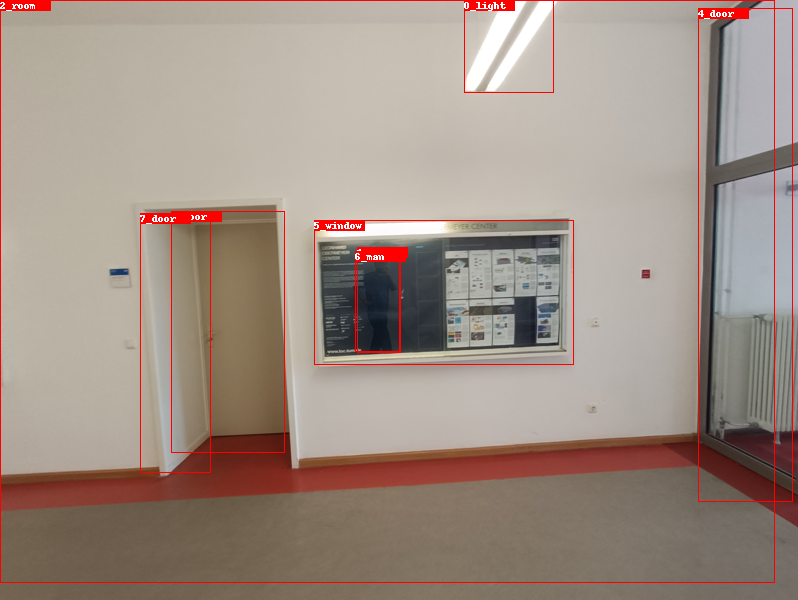

**************************************************
box_labels 0: light; score: 0.6127541065216064
box_labels 1: person; score: 0.4720914363861084
box_labels 2: room; score: 0.45322683453559875
box_labels 3: door; score: 0.41208189725875854
box_labels 4: door; score: 0.2413555085659027
box_labels 5: window; score: 0.2185261845588684
box_labels 6: man; score: 0.10910699516534805
box_labels 7: door; score: 0.1005820482969284
**************************************************
rel_labels 0: 2_room => has => 7_door; score: 0.8917452096939087
rel_labels 1: 2_room => has => 3_door; score: 0.8209072947502136
rel_labels 2: 4_door => in => 2_room; score: 0.7926437258720398
rel_labels 3: 3_door => in => 2_room; score: 0.7584724426269531
rel_labels 4: 7_door => in => 2_room; score: 0.7456204295158386
rel_labels 5: 2_room => has => 0_light; score: 0.7401492595672607
rel_labels 6: 2_room => has => 5_window; score: 0.7005621194839478
rel_labels 7: 5_window => in => 2_room; score: 0.692587673664093
rel

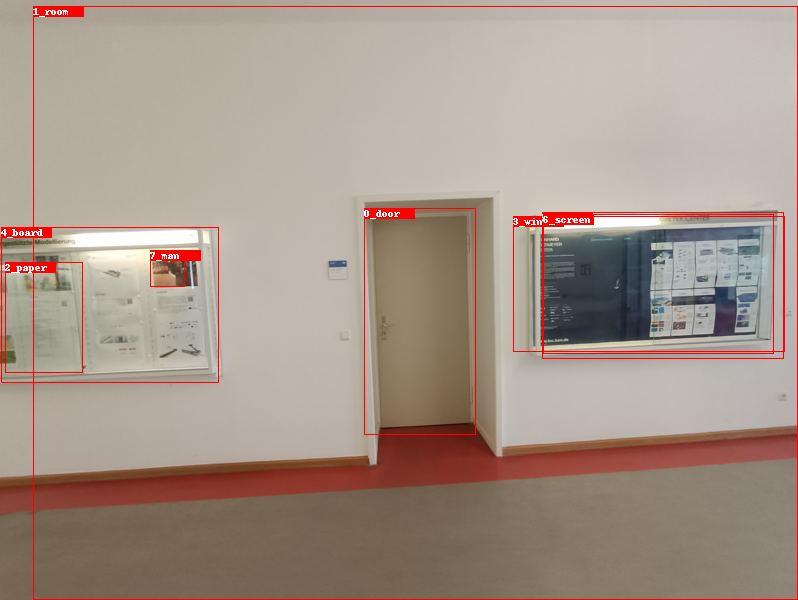

**************************************************
box_labels 0: door; score: 0.6599488854408264
box_labels 1: room; score: 0.20127326250076294
box_labels 2: paper; score: 0.11220213025808334
box_labels 3: window; score: 0.09638656675815582
box_labels 4: board; score: 0.0957794114947319
box_labels 5: board; score: 0.060849592089653015
box_labels 6: screen; score: 0.03642132133245468
box_labels 7: man; score: 0.029827671125531197
**************************************************
rel_labels 0: 1_room => has => 0_door; score: 0.8080333471298218
rel_labels 1: 5_board => in => 1_room; score: 0.7101818323135376
rel_labels 2: 1_room => has => 3_window; score: 0.6715630888938904
rel_labels 3: 0_door => in => 1_room; score: 0.6535519957542419
rel_labels 4: 1_room => has => 6_screen; score: 0.6530759930610657
rel_labels 5: 1_room => has => 2_paper; score: 0.6369345784187317
rel_labels 6: 1_room => has => 4_board; score: 0.6279328465461731
rel_labels 7: 4_board => in => 1_room; score: 0.62235528

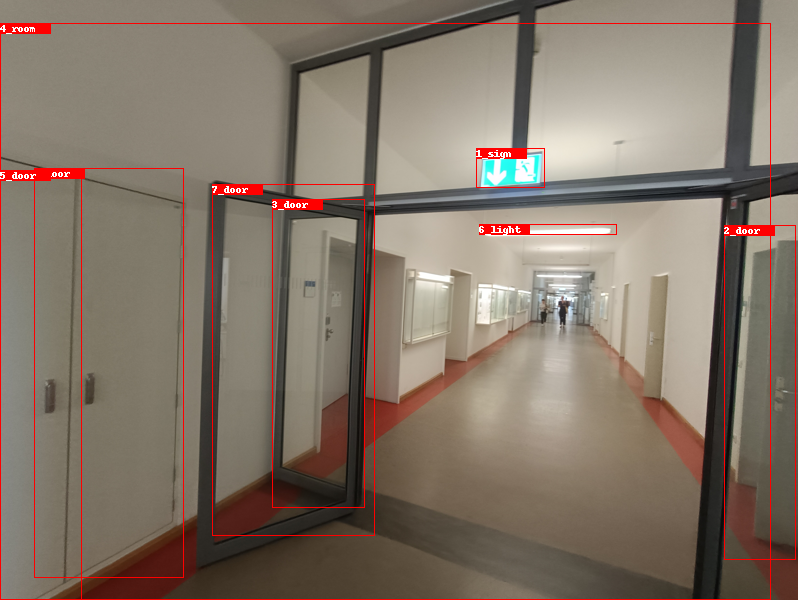

**************************************************
box_labels 0: door; score: 0.6544957756996155
box_labels 1: sign; score: 0.48347797989845276
box_labels 2: door; score: 0.46113887429237366
box_labels 3: door; score: 0.39433473348617554
box_labels 4: room; score: 0.3618258237838745
box_labels 5: door; score: 0.33435171842575073
box_labels 6: light; score: 0.310247540473938
box_labels 7: door; score: 0.12163466960191727
**************************************************
rel_labels 0: 4_room => has => 0_door; score: 0.9005818367004395
rel_labels 1: 4_room => has => 5_door; score: 0.8813519477844238
rel_labels 2: 4_room => has => 2_door; score: 0.8657635450363159
rel_labels 3: 2_door => in => 4_room; score: 0.8157318830490112
rel_labels 4: 7_door => in => 4_room; score: 0.7844162583351135
rel_labels 5: 4_room => has => 3_door; score: 0.7487868070602417
rel_labels 6: 3_door => in => 4_room; score: 0.7474730014801025
rel_labels 7: 4_room => has => 7_door; score: 0.737203061580658
rel_label

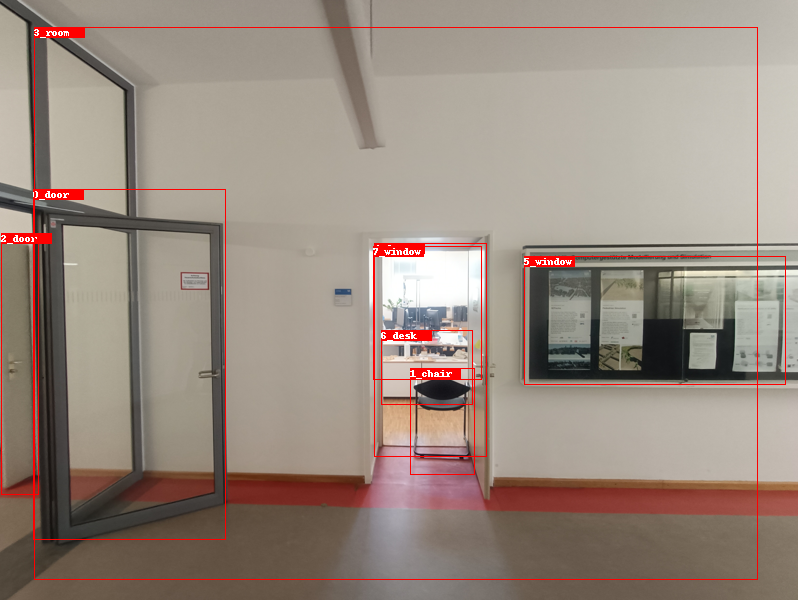

**************************************************
box_labels 0: door; score: 0.5446752309799194
box_labels 1: chair; score: 0.4146798849105835
box_labels 2: door; score: 0.4079051911830902
box_labels 3: room; score: 0.2891544699668884
box_labels 4: door; score: 0.2470913976430893
box_labels 5: window; score: 0.22030740976333618
box_labels 6: desk; score: 0.18016646802425385
box_labels 7: window; score: 0.17804543673992157
**************************************************
rel_labels 0: 6_desk => in => 3_room; score: 0.9271354079246521
rel_labels 1: 1_chair => in => 3_room; score: 0.9119300842285156
rel_labels 2: 3_room => has => 2_door; score: 0.8687041997909546
rel_labels 3: 7_window => in => 3_room; score: 0.8548110723495483
rel_labels 4: 4_door => in => 3_room; score: 0.8064655065536499
rel_labels 5: 7_window => behind => 1_chair; score: 0.7869187593460083
rel_labels 6: 3_room => has => 0_door; score: 0.7648981213569641
rel_labels 7: 0_door => in => 3_room; score: 0.763446211814880

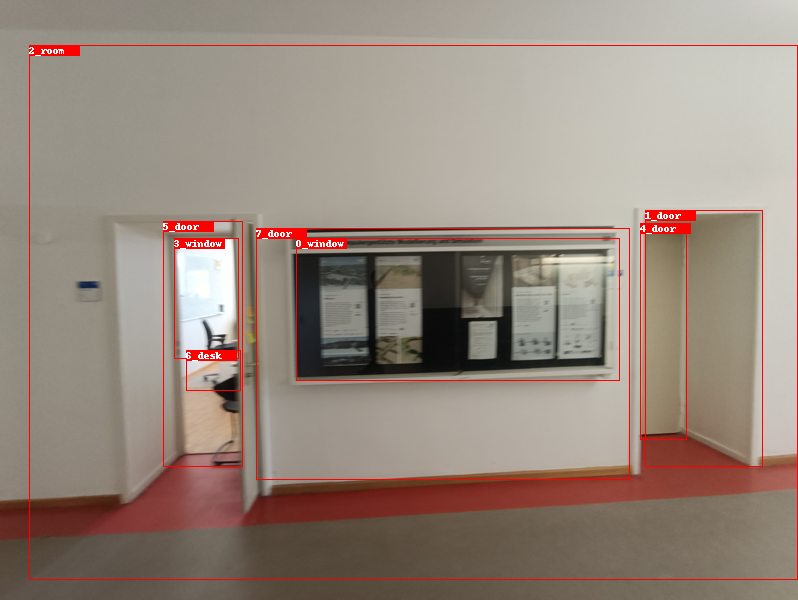

**************************************************
box_labels 0: window; score: 0.4649004638195038
box_labels 1: door; score: 0.41284120082855225
box_labels 2: room; score: 0.32985588908195496
box_labels 3: window; score: 0.21974438428878784
box_labels 4: door; score: 0.12539266049861908
box_labels 5: door; score: 0.10854782164096832
box_labels 6: desk; score: 0.08426202833652496
box_labels 7: door; score: 0.0733930692076683
**************************************************
rel_labels 0: 6_desk => in => 2_room; score: 0.9187986850738525
rel_labels 1: 2_room => has => 4_door; score: 0.8949639201164246
rel_labels 2: 2_room => has => 1_door; score: 0.8821982741355896
rel_labels 3: 2_room => has => 3_window; score: 0.8193241953849792
rel_labels 4: 3_window => in => 2_room; score: 0.8163018822669983
rel_labels 5: 7_door => in => 2_room; score: 0.8093900680541992
rel_labels 6: 2_room => has => 0_window; score: 0.7901370525360107
rel_labels 7: 5_door => in => 2_room; score: 0.752798914909362

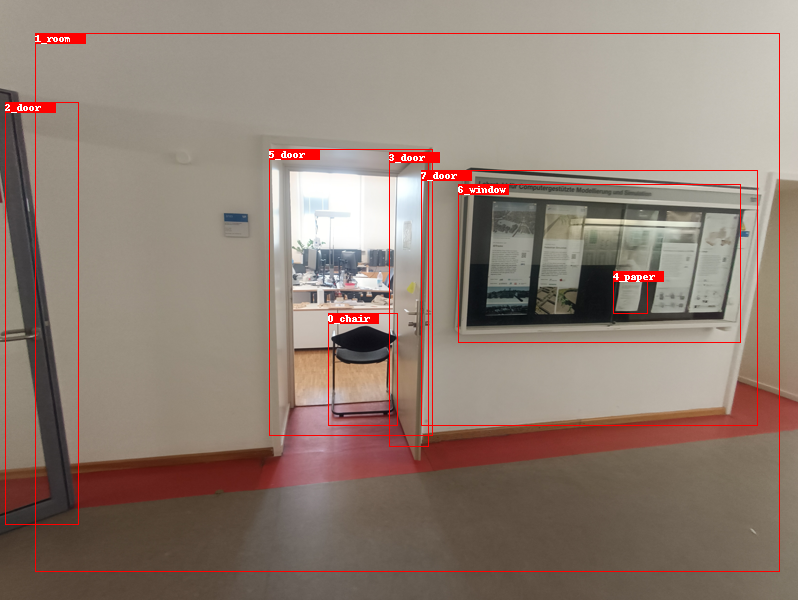

**************************************************
box_labels 0: chair; score: 0.48765894770622253
box_labels 1: room; score: 0.3681351840496063
box_labels 2: door; score: 0.3585920035839081
box_labels 3: door; score: 0.18868599832057953
box_labels 4: paper; score: 0.1755758374929428
box_labels 5: door; score: 0.16751934587955475
box_labels 6: window; score: 0.1597839742898941
box_labels 7: door; score: 0.13200388848781586
**************************************************
rel_labels 0: 0_chair => in => 1_room; score: 0.8133383393287659
rel_labels 1: 1_room => has => 6_window; score: 0.7749802470207214
rel_labels 2: 1_room => has => 3_door; score: 0.7692501544952393
rel_labels 3: 1_room => has => 2_door; score: 0.7365329265594482
rel_labels 4: 7_door => in => 1_room; score: 0.6504105925559998
rel_labels 5: 5_door => has => 3_door; score: 0.6403710842132568
rel_labels 6: 1_room => has => 7_door; score: 0.6290891170501709
rel_labels 7: 7_door => has => 4_paper; score: 0.571002185344696
r

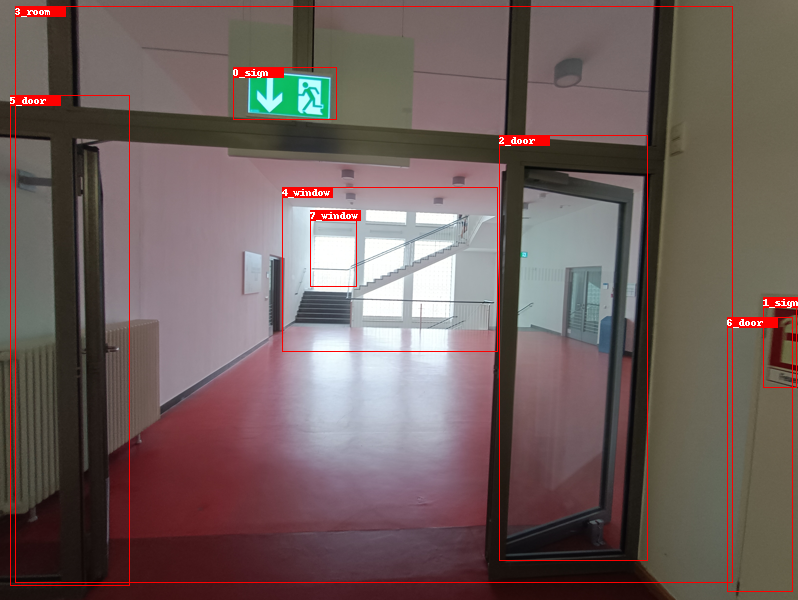

**************************************************
box_labels 0: sign; score: 0.5932126641273499
box_labels 1: sign; score: 0.49757853150367737
box_labels 2: door; score: 0.3900384306907654
box_labels 3: room; score: 0.3142854571342468
box_labels 4: window; score: 0.2386854887008667
box_labels 5: door; score: 0.16167309880256653
box_labels 6: door; score: 0.09952709078788757
box_labels 7: window; score: 0.09941621124744415
**************************************************
rel_labels 0: 3_room => has => 6_door; score: 0.8303884267807007
rel_labels 1: 3_room => has => 7_window; score: 0.7702451348304749
rel_labels 2: 7_window => in => 3_room; score: 0.7677977681159973
rel_labels 3: 4_window => in => 3_room; score: 0.7360036969184875
rel_labels 4: 5_door => in => 3_room; score: 0.7283340692520142
rel_labels 5: 3_room => has => 1_sign; score: 0.6802067756652832
rel_labels 6: 3_room => has => 2_door; score: 0.6799560785293579
rel_labels 7: 2_door => in => 3_room; score: 0.6707998514175415


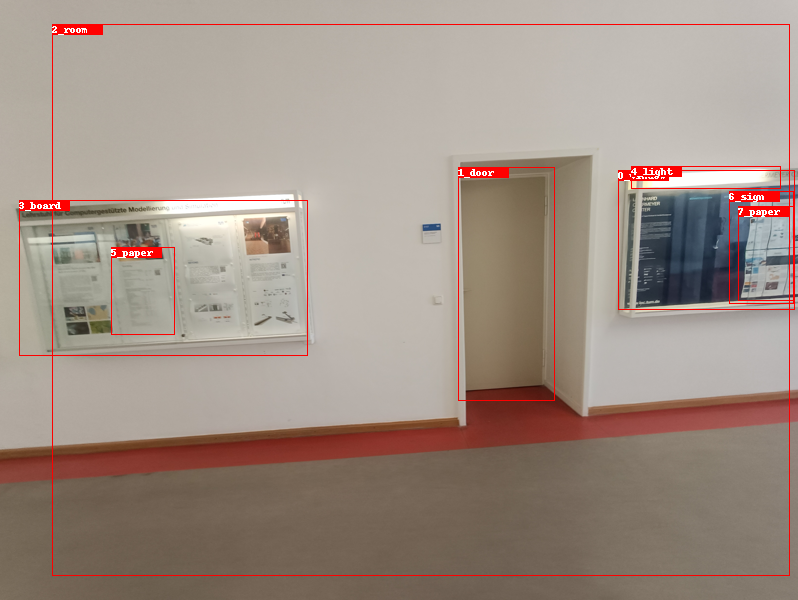

**************************************************
box_labels 0: window; score: 0.38831666111946106
box_labels 1: door; score: 0.27789047360420227
box_labels 2: room; score: 0.21681003272533417
box_labels 3: board; score: 0.17157794535160065
box_labels 4: light; score: 0.10174408555030823
box_labels 5: paper; score: 0.07258963584899902
box_labels 6: sign; score: 0.03408144414424896
box_labels 7: paper; score: 0.03210217505693436
**************************************************
rel_labels 0: 2_room => has => 1_door; score: 0.7911935448646545
rel_labels 1: 2_room => has => 0_window; score: 0.7549339532852173
rel_labels 2: 2_room => has => 7_paper; score: 0.699321448802948
rel_labels 3: 2_room => has => 6_sign; score: 0.6907694935798645
rel_labels 4: 3_board => in => 2_room; score: 0.6366798281669617
rel_labels 5: 1_door => in => 2_room; score: 0.6251309514045715
rel_labels 6: 2_room => has => 4_light; score: 0.6113989949226379
rel_labels 7: 6_sign => in => 2_room; score: 0.558957159519

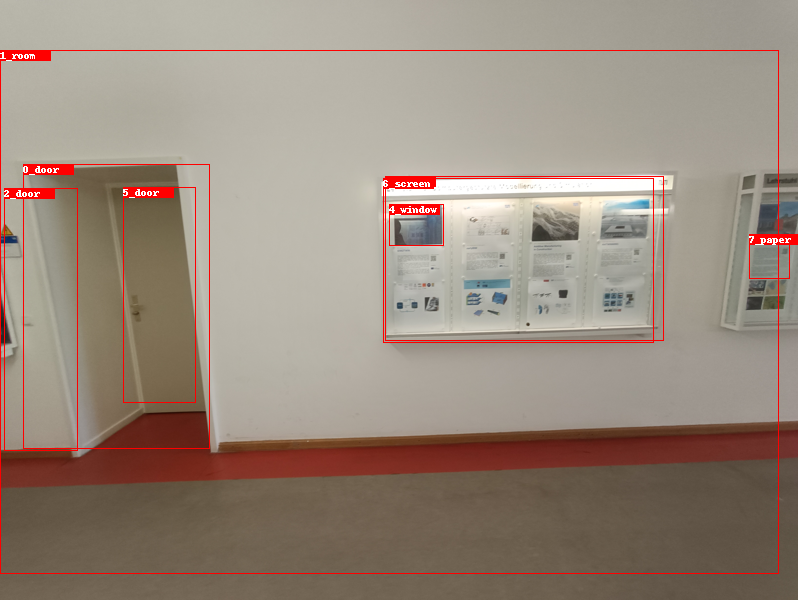

**************************************************
box_labels 0: door; score: 0.7041310667991638
box_labels 1: room; score: 0.13976377248764038
box_labels 2: door; score: 0.13518227636814117
box_labels 3: window; score: 0.05972002446651459
box_labels 4: window; score: 0.039709318429231644
box_labels 5: door; score: 0.03382937237620354
box_labels 6: screen; score: 0.0328819677233696
box_labels 7: paper; score: 0.020414089784026146
**************************************************
rel_labels 0: 1_room => has => 2_door; score: 0.9024556875228882
rel_labels 1: 1_room => has => 5_door; score: 0.8832048177719116
rel_labels 2: 1_room => has => 0_door; score: 0.8588064908981323
rel_labels 3: 1_room => has => 3_window; score: 0.6908975839614868
rel_labels 4: 0_door => in => 1_room; score: 0.6007671356201172
rel_labels 5: 5_door => in => 1_room; score: 0.5705583691596985
rel_labels 6: 4_window => in => 1_room; score: 0.552704930305481
rel_labels 7: 1_room => has => 6_screen; score: 0.5472592711

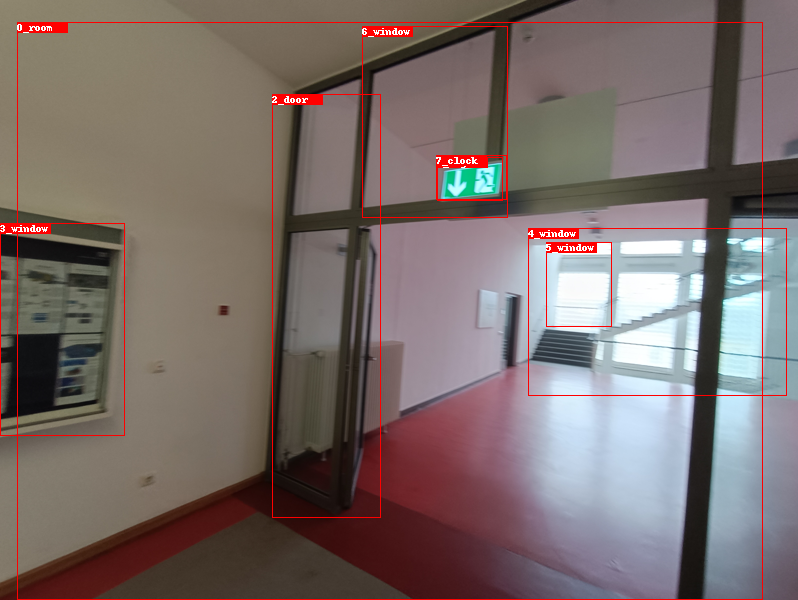

**************************************************
box_labels 0: room; score: 0.4953533113002777
box_labels 1: sign; score: 0.37939736247062683
box_labels 2: door; score: 0.3668157160282135
box_labels 3: window; score: 0.27927061915397644
box_labels 4: window; score: 0.2257896363735199
box_labels 5: window; score: 0.14816391468048096
box_labels 6: window; score: 0.14791631698608398
box_labels 7: clock; score: 0.0817929059267044
**************************************************
rel_labels 0: 5_window => in => 0_room; score: 0.8347935080528259
rel_labels 1: 0_room => has => 5_window; score: 0.8199464678764343
rel_labels 2: 2_door => in => 0_room; score: 0.8026025295257568
rel_labels 3: 0_room => has => 3_window; score: 0.7864203453063965
rel_labels 4: 3_window => in => 0_room; score: 0.7759596705436707
rel_labels 5: 0_room => has => 4_window; score: 0.7442979216575623
rel_labels 6: 0_room => has => 6_window; score: 0.7245336174964905
rel_labels 7: 0_room => has => 2_door; score: 0.69768

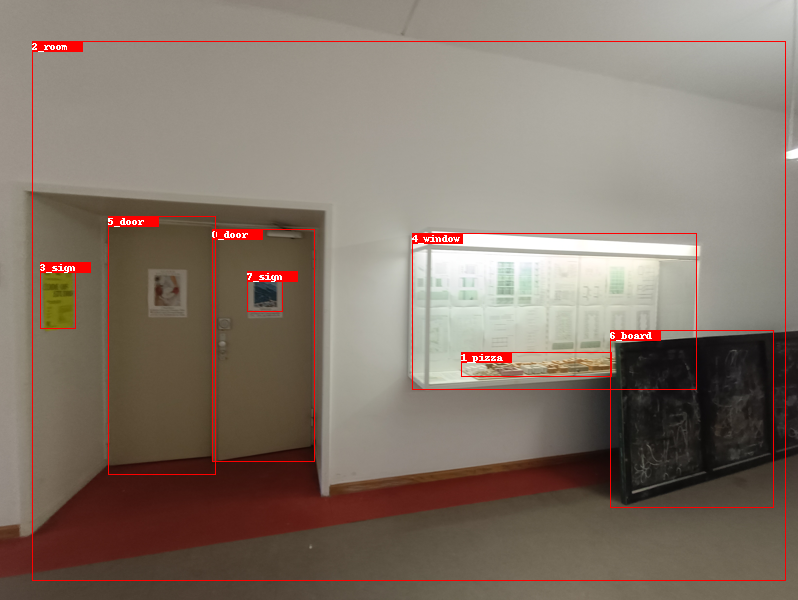

**************************************************
box_labels 0: door; score: 0.6674854159355164
box_labels 1: pizza; score: 0.5929886102676392
box_labels 2: room; score: 0.37350067496299744
box_labels 3: sign; score: 0.3650147318840027
box_labels 4: window; score: 0.27606281638145447
box_labels 5: door; score: 0.24721015989780426
box_labels 6: board; score: 0.1919969618320465
box_labels 7: sign; score: 0.15537507832050323
**************************************************
rel_labels 0: 2_room => has => 0_door; score: 0.9058621525764465
rel_labels 1: 6_board => in => 2_room; score: 0.8807565569877625
rel_labels 2: 5_door => in => 2_room; score: 0.7955996990203857
rel_labels 3: 1_pizza => in => 2_room; score: 0.7954090237617493
rel_labels 4: 0_door => in => 2_room; score: 0.7914769649505615
rel_labels 5: 2_room => has => 5_door; score: 0.7647871375083923
rel_labels 6: 2_room => has => 4_window; score: 0.7418849468231201
rel_labels 7: 7_sign => in => 2_room; score: 0.6829477548599243
rel

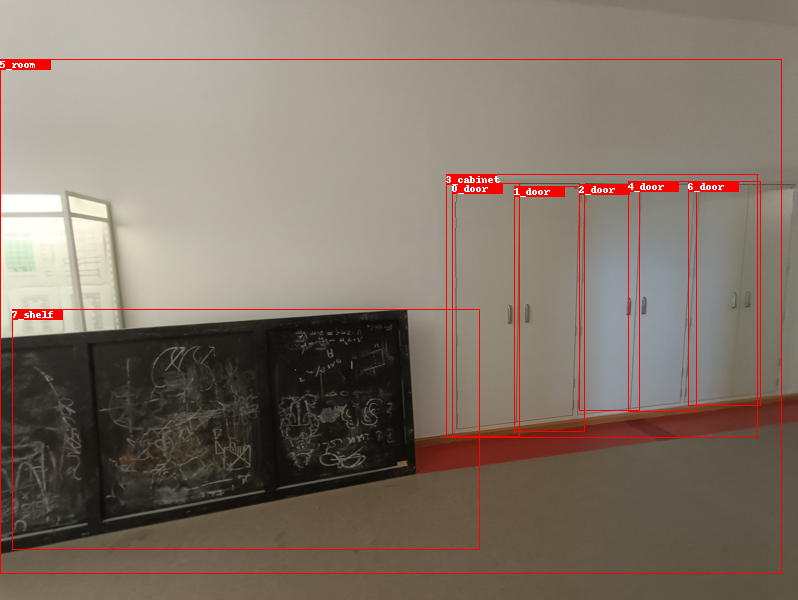

**************************************************
box_labels 0: door; score: 0.5607872009277344
box_labels 1: door; score: 0.43086209893226624
box_labels 2: door; score: 0.3513340353965759
box_labels 3: cabinet; score: 0.2346707135438919
box_labels 4: door; score: 0.2189529687166214
box_labels 5: room; score: 0.21109718084335327
box_labels 6: door; score: 0.18963909149169922
box_labels 7: shelf; score: 0.08710085600614548
**************************************************
rel_labels 0: 5_room => has => 6_door; score: 0.8803471326828003
rel_labels 1: 5_room => has => 4_door; score: 0.878089189529419
rel_labels 2: 5_room => has => 2_door; score: 0.8722224235534668
rel_labels 3: 5_room => has => 0_door; score: 0.8601800799369812
rel_labels 4: 5_room => has => 1_door; score: 0.8563381433486938
rel_labels 5: 7_shelf => in => 5_room; score: 0.789310097694397
rel_labels 6: 3_cabinet => has => 4_door; score: 0.6310378313064575
rel_labels 7: 3_cabinet => has => 1_door; score: 0.609351158142089

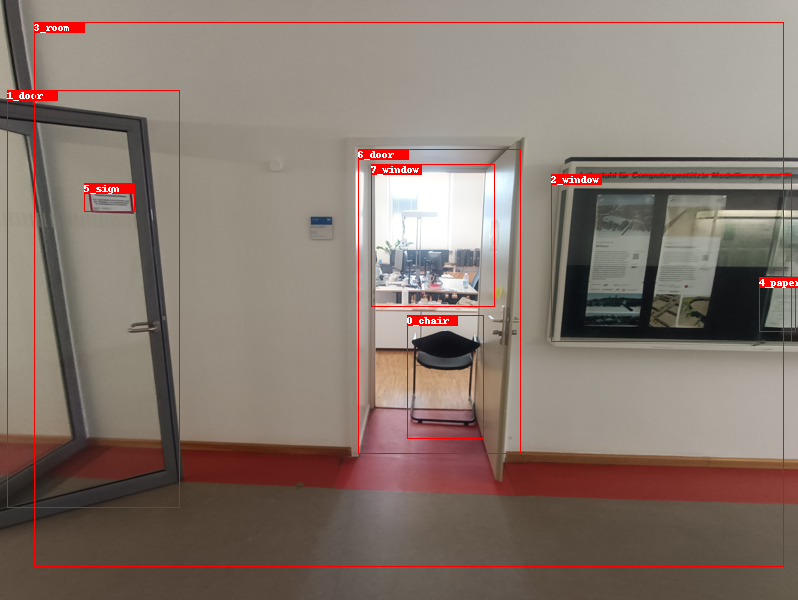

**************************************************
box_labels 0: chair; score: 0.6228132247924805
box_labels 1: door; score: 0.609908938407898
box_labels 2: window; score: 0.41700413823127747
box_labels 3: room; score: 0.30036112666130066
box_labels 4: paper; score: 0.28649404644966125
box_labels 5: sign; score: 0.26664823293685913
box_labels 6: door; score: 0.2104586511850357
box_labels 7: window; score: 0.13892972469329834
**************************************************
rel_labels 0: 0_chair => in => 3_room; score: 0.8431100845336914
rel_labels 1: 7_window => in => 3_room; score: 0.7382456064224243
rel_labels 2: 3_room => has => 2_window; score: 0.646035373210907
rel_labels 3: 3_room => has => 4_paper; score: 0.6182528734207153
rel_labels 4: 6_door => in => 3_room; score: 0.5948242545127869
rel_labels 5: 3_room => has => 1_door; score: 0.5746303200721741
rel_labels 6: 2_window => has => 4_paper; score: 0.56737220287323
rel_labels 7: 1_door => in => 3_room; score: 0.547273337841033

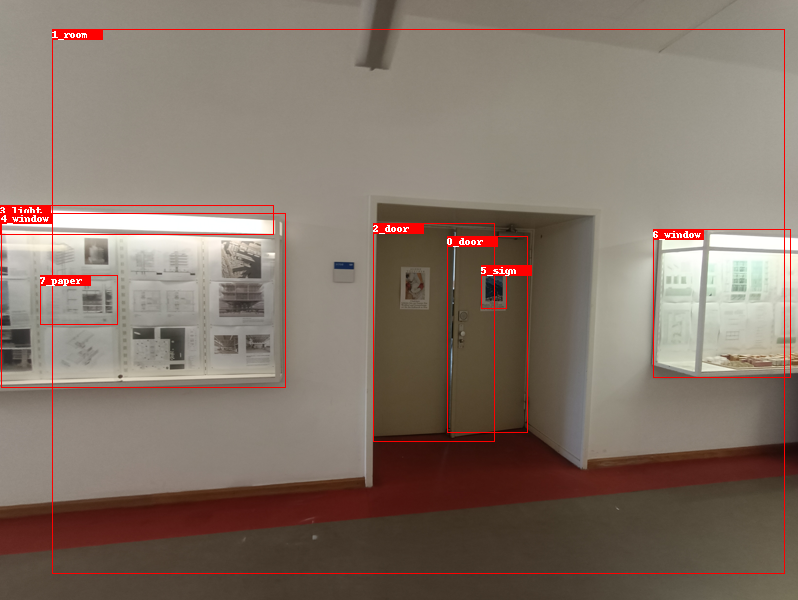

**************************************************
box_labels 0: door; score: 0.6320536136627197
box_labels 1: room; score: 0.31272852420806885
box_labels 2: door; score: 0.30981552600860596
box_labels 3: light; score: 0.2323143184185028
box_labels 4: window; score: 0.20757752656936646
box_labels 5: sign; score: 0.1642053723335266
box_labels 6: window; score: 0.1261471062898636
box_labels 7: paper; score: 0.10771027207374573
**************************************************
rel_labels 0: 1_room => has => 0_door; score: 0.917718231678009
rel_labels 1: 1_room => has => 2_door; score: 0.8981717228889465
rel_labels 2: 1_room => has => 6_window; score: 0.7649130821228027
rel_labels 3: 1_room => has => 4_window; score: 0.7263680100440979
rel_labels 4: 0_door => in => 1_room; score: 0.6642712950706482
rel_labels 5: 1_room => has => 5_sign; score: 0.6636731624603271
rel_labels 6: 2_door => in => 1_room; score: 0.6432937979698181
rel_labels 7: 5_sign => in => 1_room; score: 0.6370117664337158


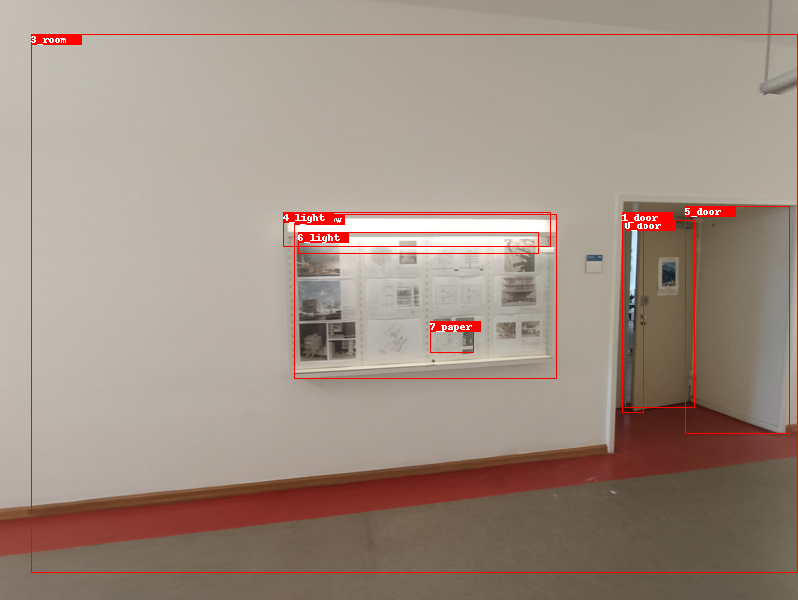

**************************************************
box_labels 0: door; score: 0.5431012511253357
box_labels 1: door; score: 0.47120559215545654
box_labels 2: window; score: 0.36454129219055176
box_labels 3: room; score: 0.3258041441440582
box_labels 4: light; score: 0.28003084659576416
box_labels 5: door; score: 0.1043396145105362
box_labels 6: light; score: 0.05171552672982216
box_labels 7: paper; score: 0.045100387185811996
**************************************************
rel_labels 0: 3_room => has => 1_door; score: 0.9290834665298462
rel_labels 1: 3_room => has => 0_door; score: 0.8872170448303223
rel_labels 2: 3_room => has => 5_door; score: 0.8831534385681152
rel_labels 3: 3_room => has => 2_window; score: 0.727537214756012
rel_labels 4: 3_room => has => 6_light; score: 0.6551965475082397
rel_labels 5: 3_room => has => 4_light; score: 0.6434824466705322
rel_labels 6: 5_door => in => 3_room; score: 0.6358944773674011
rel_labels 7: 0_door => has => 1_door; score: 0.63456887006759

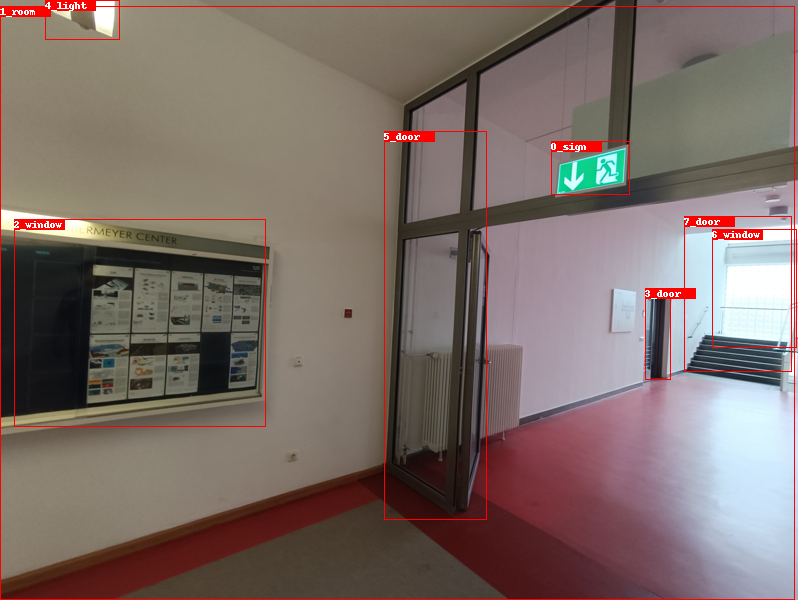

**************************************************
box_labels 0: sign; score: 0.5845448970794678
box_labels 1: room; score: 0.47351542115211487
box_labels 2: window; score: 0.42322754859924316
box_labels 3: door; score: 0.4012528359889984
box_labels 4: light; score: 0.3823094964027405
box_labels 5: door; score: 0.27355897426605225
box_labels 6: window; score: 0.14325600862503052
box_labels 7: door; score: 0.1428406685590744
**************************************************
rel_labels 0: 1_room => has => 3_door; score: 0.9049373269081116
rel_labels 1: 1_room => has => 2_window; score: 0.8540234565734863
rel_labels 2: 1_room => has => 6_window; score: 0.8348903059959412
rel_labels 3: 7_door => in => 1_room; score: 0.811170756816864
rel_labels 4: 1_room => has => 4_light; score: 0.7736353278160095
rel_labels 5: 1_room => has => 7_door; score: 0.768688976764679
rel_labels 6: 5_door => in => 1_room; score: 0.7452579736709595
rel_labels 7: 1_room => has => 5_door; score: 0.7294948101043701


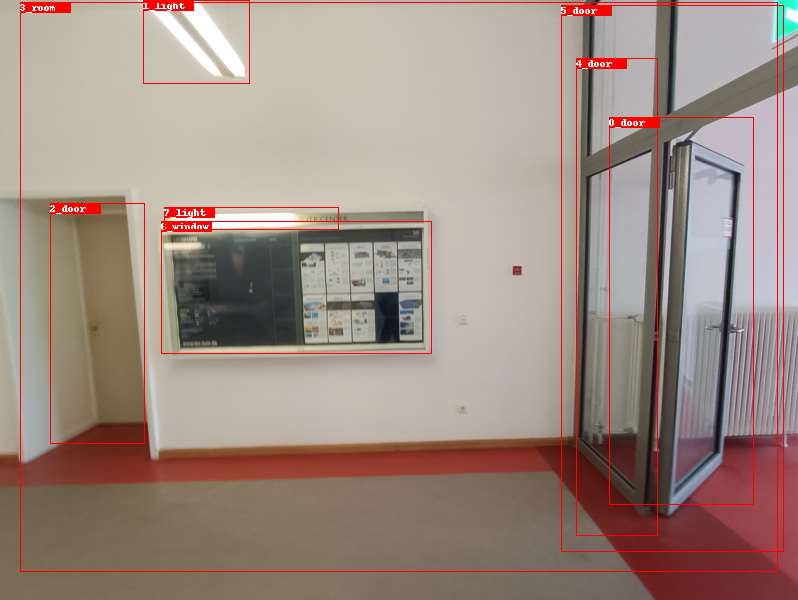

**************************************************
box_labels 0: door; score: 0.6605080366134644
box_labels 1: light; score: 0.6245388388633728
box_labels 2: door; score: 0.32303884625434875
box_labels 3: room; score: 0.31688016653060913
box_labels 4: door; score: 0.20157870650291443
box_labels 5: door; score: 0.15103194117546082
box_labels 6: window; score: 0.14029563963413239
box_labels 7: light; score: 0.11769040673971176
**************************************************
rel_labels 0: 3_room => has => 2_door; score: 0.858002781867981
rel_labels 1: 3_room => has => 0_door; score: 0.8470423817634583
rel_labels 2: 3_room => has => 4_door; score: 0.8156376481056213
rel_labels 3: 5_door => in => 3_room; score: 0.8037503957748413
rel_labels 4: 2_door => in => 3_room; score: 0.7883197069168091
rel_labels 5: 4_door => in => 3_room; score: 0.7843340039253235
rel_labels 6: 0_door => in => 3_room; score: 0.7253618240356445
rel_labels 7: 6_window => in => 3_room; score: 0.72525554895401
rel_la

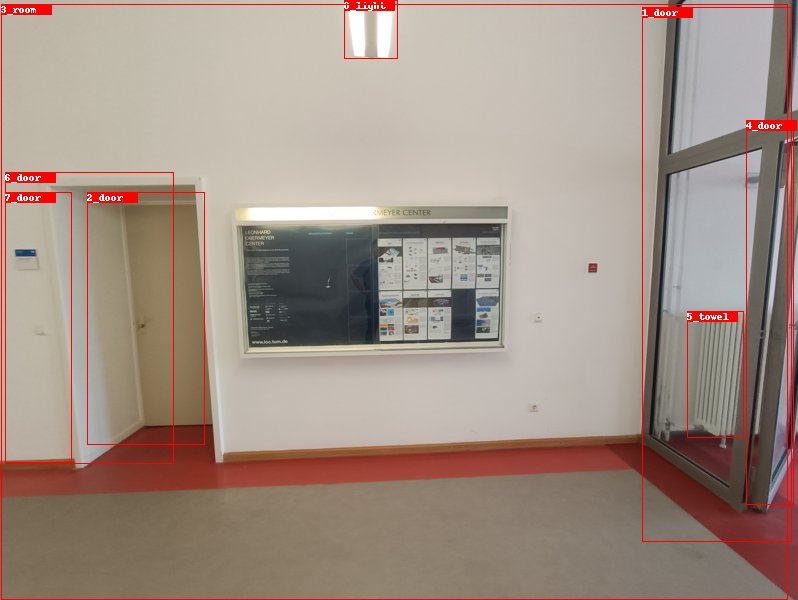

**************************************************
box_labels 0: light; score: 0.54742032289505
box_labels 1: door; score: 0.5150429010391235
box_labels 2: door; score: 0.3465307354927063
box_labels 3: room; score: 0.22521384060382843
box_labels 4: door; score: 0.11279789358377457
box_labels 5: towel; score: 0.05883258953690529
box_labels 6: door; score: 0.05125625431537628
box_labels 7: door; score: 0.05089062079787254
**************************************************
rel_labels 0: 3_room => has => 4_door; score: 0.8731223940849304
rel_labels 1: 3_room => has => 7_door; score: 0.8506870269775391
rel_labels 2: 1_door => has => 4_door; score: 0.8296990394592285
rel_labels 3: 3_room => has => 2_door; score: 0.8234217762947083
rel_labels 4: 7_door => in => 3_room; score: 0.8218033909797668
rel_labels 5: 3_room => has => 6_door; score: 0.8090782761573792
rel_labels 6: 1_door => in => 3_room; score: 0.7626148462295532
rel_labels 7: 6_door => in => 3_room; score: 0.7425661683082581
rel_labe

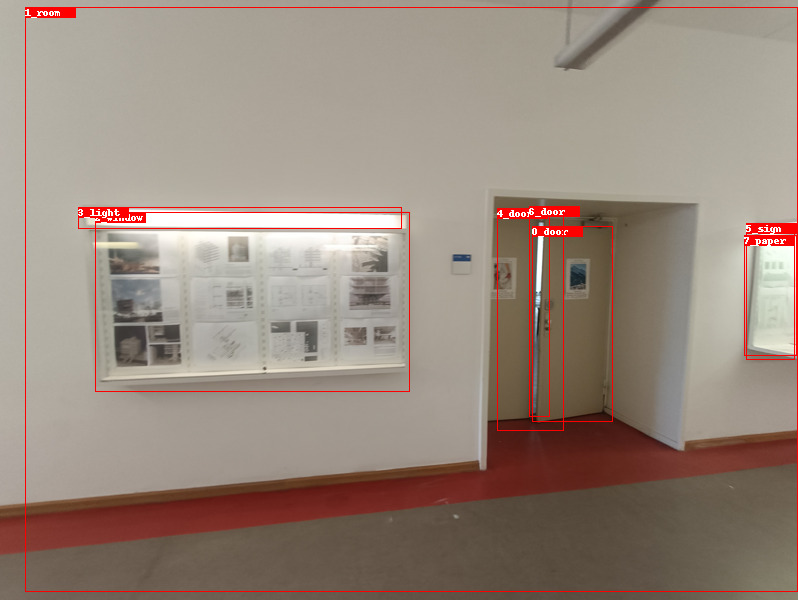

**************************************************
box_labels 0: door; score: 0.533633291721344
box_labels 1: room; score: 0.42747753858566284
box_labels 2: window; score: 0.4265636205673218
box_labels 3: light; score: 0.21863460540771484
box_labels 4: door; score: 0.15666846930980682
box_labels 5: sign; score: 0.1374559849500656
box_labels 6: door; score: 0.09729572385549545
box_labels 7: paper; score: 0.07962774485349655
**************************************************
rel_labels 0: 1_room => has => 0_door; score: 0.915892481803894
rel_labels 1: 1_room => has => 4_door; score: 0.8999060392379761
rel_labels 2: 1_room => has => 6_door; score: 0.899679958820343
rel_labels 3: 4_door => in => 1_room; score: 0.7047853469848633
rel_labels 4: 0_door => in => 1_room; score: 0.7008081078529358
rel_labels 5: 1_room => has => 2_window; score: 0.6852375864982605
rel_labels 6: 0_door => has => 6_door; score: 0.6728037595748901
rel_labels 7: 2_window => in => 1_room; score: 0.6576472520828247
rel

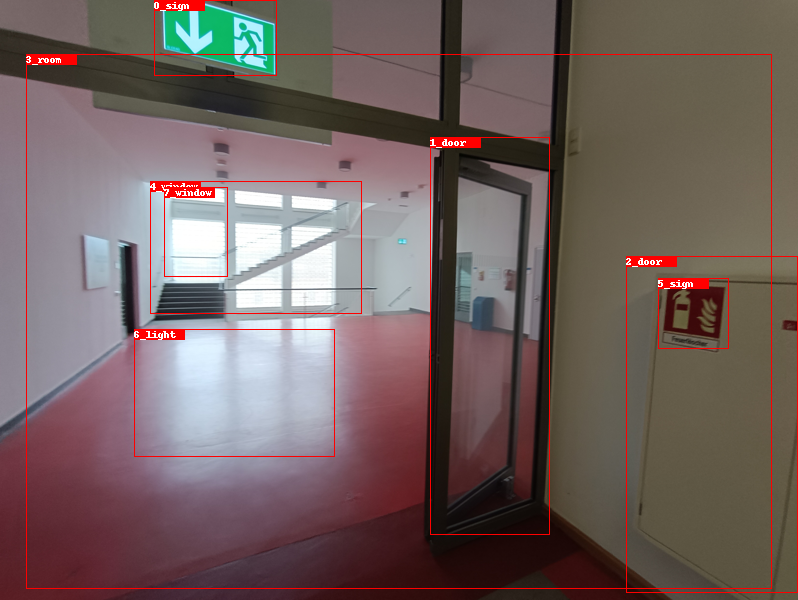

**************************************************
box_labels 0: sign; score: 0.686326265335083
box_labels 1: door; score: 0.6767682433128357
box_labels 2: door; score: 0.5172726511955261
box_labels 3: room; score: 0.44977012276649475
box_labels 4: window; score: 0.3590354323387146
box_labels 5: sign; score: 0.31834083795547485
box_labels 6: light; score: 0.2297791987657547
box_labels 7: window; score: 0.20173980295658112
**************************************************
rel_labels 0: 2_door => in => 3_room; score: 0.8707122206687927
rel_labels 1: 3_room => has => 2_door; score: 0.8268364667892456
rel_labels 2: 7_window => in => 3_room; score: 0.8193174004554749
rel_labels 3: 3_room => has => 1_door; score: 0.8101425170898438
rel_labels 4: 3_room => has => 7_window; score: 0.8099870085716248
rel_labels 5: 4_window => in => 3_room; score: 0.7603474259376526
rel_labels 6: 1_door => in => 3_room; score: 0.7428691387176514
rel_labels 7: 3_room => has => 4_window; score: 0.7375723123550415

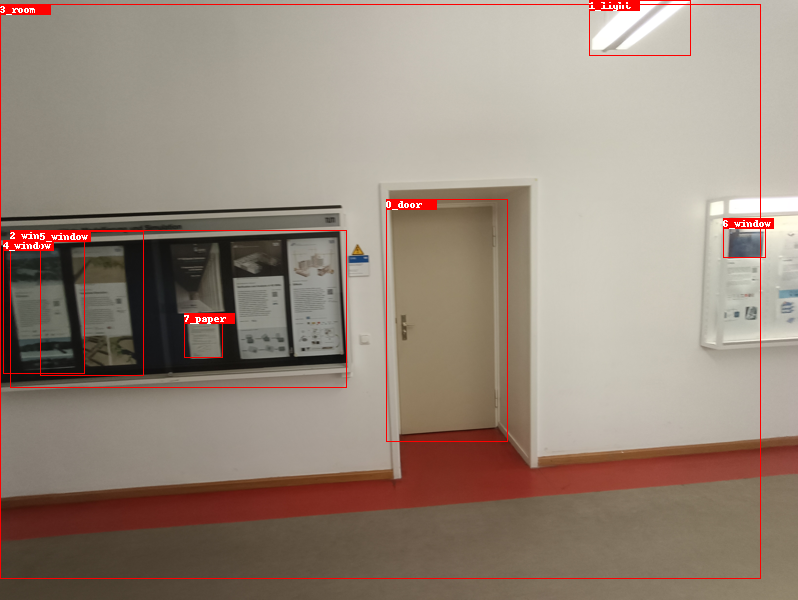

**************************************************
box_labels 0: door; score: 0.7074988484382629
box_labels 1: light; score: 0.5944716930389404
box_labels 2: window; score: 0.3259660601615906
box_labels 3: room; score: 0.19988496601581573
box_labels 4: window; score: 0.17669720947742462
box_labels 5: window; score: 0.1052754744887352
box_labels 6: window; score: 0.06311129033565521
box_labels 7: paper; score: 0.050549354404211044
**************************************************
rel_labels 0: 3_room => has => 0_door; score: 0.8423861861228943
rel_labels 1: 3_room => has => 2_window; score: 0.8118224740028381
rel_labels 2: 3_room => has => 4_window; score: 0.7996669411659241
rel_labels 3: 3_room => has => 1_light; score: 0.7532328963279724
rel_labels 4: 5_window => in => 3_room; score: 0.7525589466094971
rel_labels 5: 3_room => has => 5_window; score: 0.7339473366737366
rel_labels 6: 4_window => in => 3_room; score: 0.7034461498260498
rel_labels 7: 0_door => in => 3_room; score: 0.6922

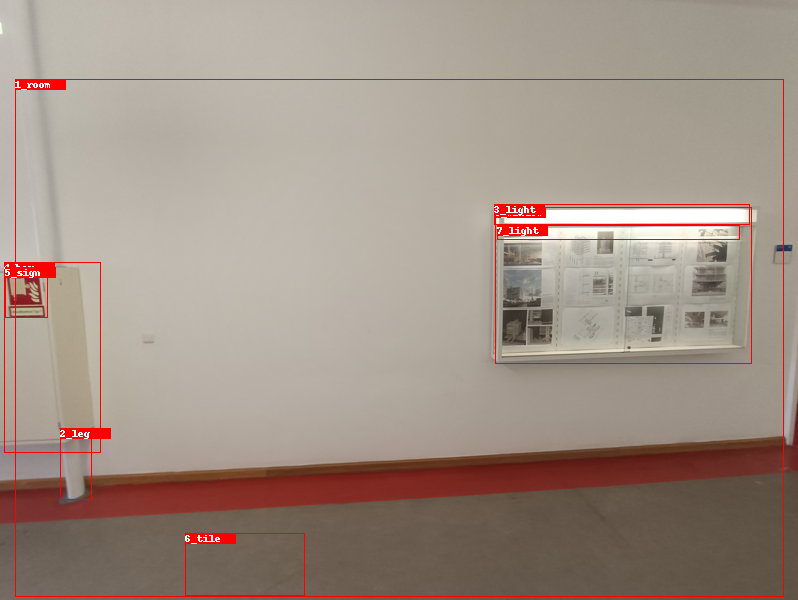

**************************************************
box_labels 0: window; score: 0.36962491273880005
box_labels 1: room; score: 0.27232885360717773
box_labels 2: leg; score: 0.26095548272132874
box_labels 3: light; score: 0.2102867066860199
box_labels 4: box; score: 0.14869828522205353
box_labels 5: sign; score: 0.11639489978551865
box_labels 6: tile; score: 0.061339933425188065
box_labels 7: light; score: 0.03257853165268898
**************************************************
rel_labels 0: 1_room => has => 0_window; score: 0.7953439354896545
rel_labels 1: 1_room => has => 2_leg; score: 0.7491694688796997
rel_labels 2: 1_room => has => 7_light; score: 0.740973711013794
rel_labels 3: 1_room => has => 3_light; score: 0.6717073321342468
rel_labels 4: 1_room => has => 4_box; score: 0.6577006578445435
rel_labels 5: 6_tile => under => 7_light; score: 0.6331825852394104
rel_labels 6: 1_room => has => 5_sign; score: 0.6093218326568604
rel_labels 7: 6_tile => under => 0_window; score: 0.603305816

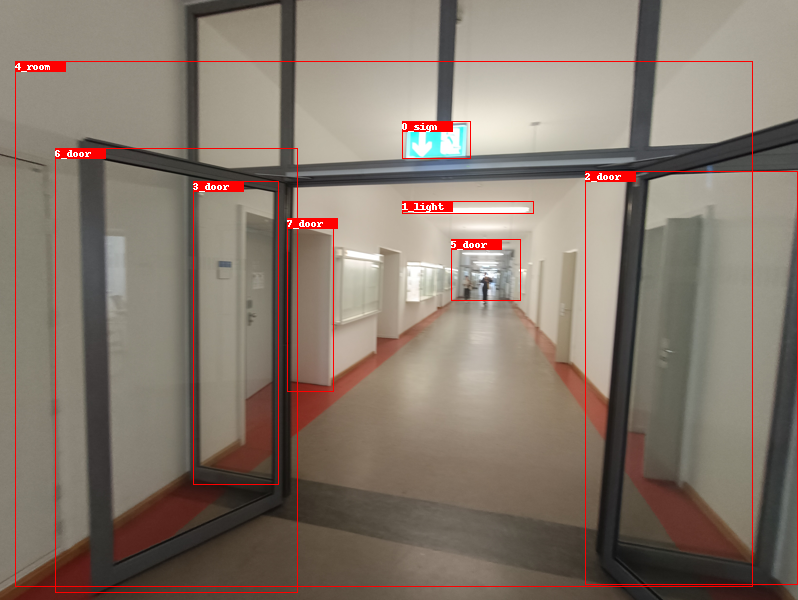

**************************************************
box_labels 0: sign; score: 0.4947172701358795
box_labels 1: light; score: 0.4450225532054901
box_labels 2: door; score: 0.31291159987449646
box_labels 3: door; score: 0.28965672850608826
box_labels 4: room; score: 0.25842222571372986
box_labels 5: door; score: 0.2308385819196701
box_labels 6: door; score: 0.1973978877067566
box_labels 7: door; score: 0.1515320986509323
**************************************************
rel_labels 0: 4_room => has => 7_door; score: 0.8587731122970581
rel_labels 1: 4_room => has => 5_door; score: 0.8226804137229919
rel_labels 2: 6_door => has => 7_door; score: 0.7725818753242493
rel_labels 3: 4_room => has => 3_door; score: 0.7613290548324585
rel_labels 4: 2_door => in => 4_room; score: 0.7514595985412598
rel_labels 5: 5_door => in => 4_room; score: 0.7465528845787048
rel_labels 6: 3_door => in => 4_room; score: 0.7309203743934631
rel_labels 7: 6_door => in => 4_room; score: 0.7211394309997559
rel_labels

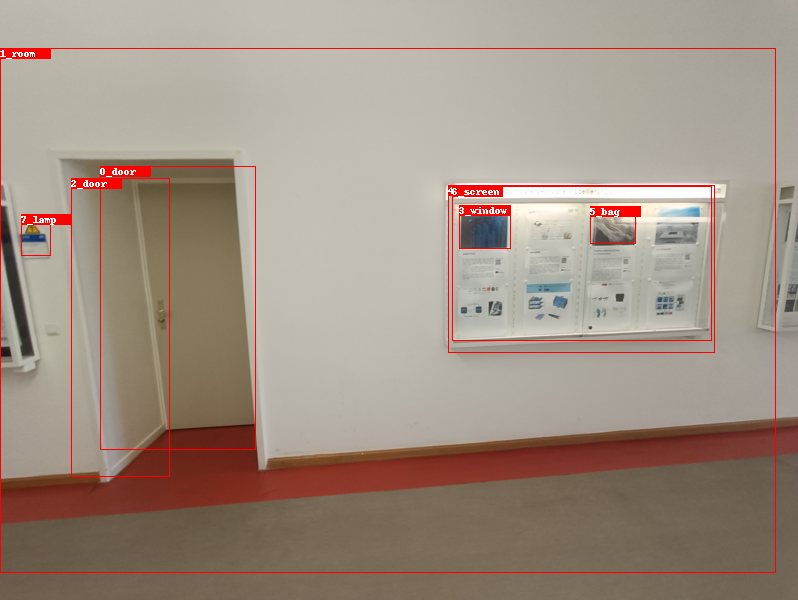

**************************************************
box_labels 0: door; score: 0.662248969078064
box_labels 1: room; score: 0.2196589559316635
box_labels 2: door; score: 0.19279125332832336
box_labels 3: window; score: 0.05927048623561859
box_labels 4: window; score: 0.04904067888855934
box_labels 5: bag; score: 0.038927119225263596
box_labels 6: screen; score: 0.03335851430892944
box_labels 7: lamp; score: 0.023055216297507286
**************************************************
rel_labels 0: 1_room => has => 2_door; score: 0.9224857687950134
rel_labels 1: 1_room => has => 0_door; score: 0.8400058150291443
rel_labels 2: 1_room => has => 4_window; score: 0.7210444808006287
rel_labels 3: 0_door => has => 2_door; score: 0.6324743032455444
rel_labels 4: 1_room => has => 6_screen; score: 0.6070898771286011
rel_labels 5: 5_bag => in => 1_room; score: 0.6043132543563843
rel_labels 6: 0_door => in => 1_room; score: 0.579839825630188
rel_labels 7: 7_lamp => in => 1_room; score: 0.5463292002677917

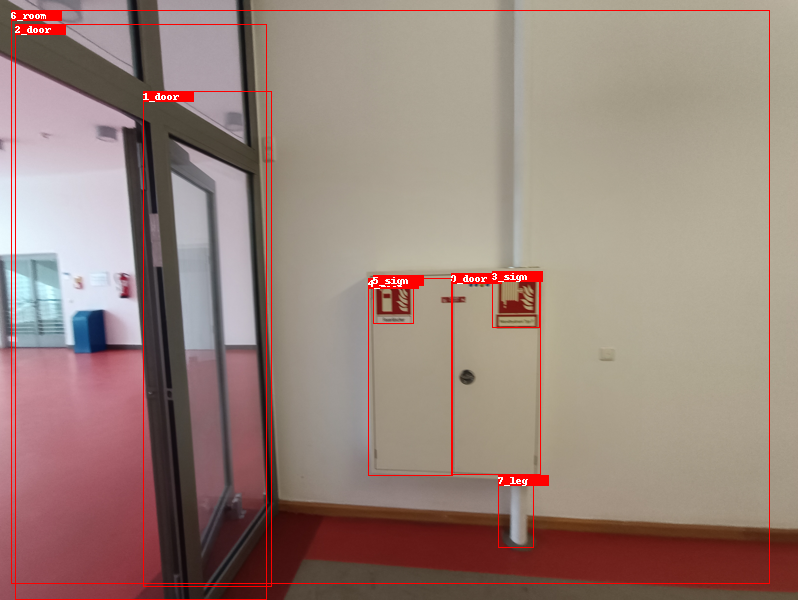

**************************************************
box_labels 0: door; score: 0.6833890080451965
box_labels 1: door; score: 0.6531112790107727
box_labels 2: door; score: 0.5131132006645203
box_labels 3: sign; score: 0.41062888503074646
box_labels 4: door; score: 0.3439255356788635
box_labels 5: sign; score: 0.3126813769340515
box_labels 6: room; score: 0.24387142062187195
box_labels 7: leg; score: 0.20933593809604645
**************************************************
rel_labels 0: 6_room => has => 4_door; score: 0.8958972096443176
rel_labels 1: 6_room => has => 0_door; score: 0.8920255899429321
rel_labels 2: 6_room => has => 7_leg; score: 0.888272762298584
rel_labels 3: 2_door => has => 7_leg; score: 0.8144454956054688
rel_labels 4: 6_room => has => 1_door; score: 0.8004287481307983
rel_labels 5: 2_door => has => 4_door; score: 0.7572066783905029
rel_labels 6: 2_door => has => 0_door; score: 0.7377094626426697
rel_labels 7: 6_room => has => 3_sign; score: 0.7023128271102905
rel_labels 

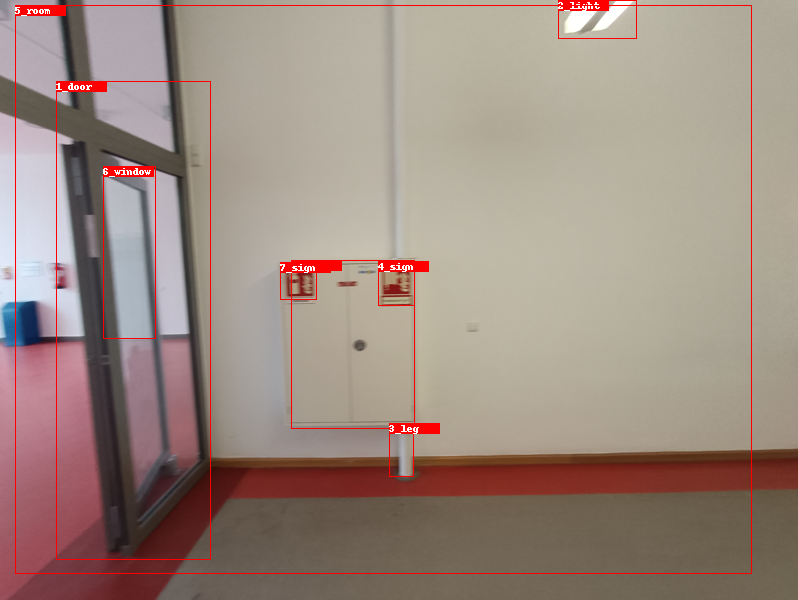

**************************************************
box_labels 0: door; score: 0.5876684188842773
box_labels 1: door; score: 0.5350170135498047
box_labels 2: light; score: 0.40168336033821106
box_labels 3: leg; score: 0.18328534066677094
box_labels 4: sign; score: 0.1798403114080429
box_labels 5: room; score: 0.17295311391353607
box_labels 6: window; score: 0.07288414984941483
box_labels 7: sign; score: 0.06869122385978699
**************************************************
rel_labels 0: 5_room => has => 0_door; score: 0.8805042505264282
rel_labels 1: 5_room => has => 2_light; score: 0.8029465079307556
rel_labels 2: 5_room => has => 1_door; score: 0.7945238947868347
rel_labels 3: 5_room => has => 6_window; score: 0.7715246081352234
rel_labels 4: 1_door => has => 6_window; score: 0.6853023171424866
rel_labels 5: 1_door => in => 5_room; score: 0.6547573208808899
rel_labels 6: 5_room => has => 7_sign; score: 0.6292270421981812
rel_labels 7: 6_window => in => 5_room; score: 0.625939130783081

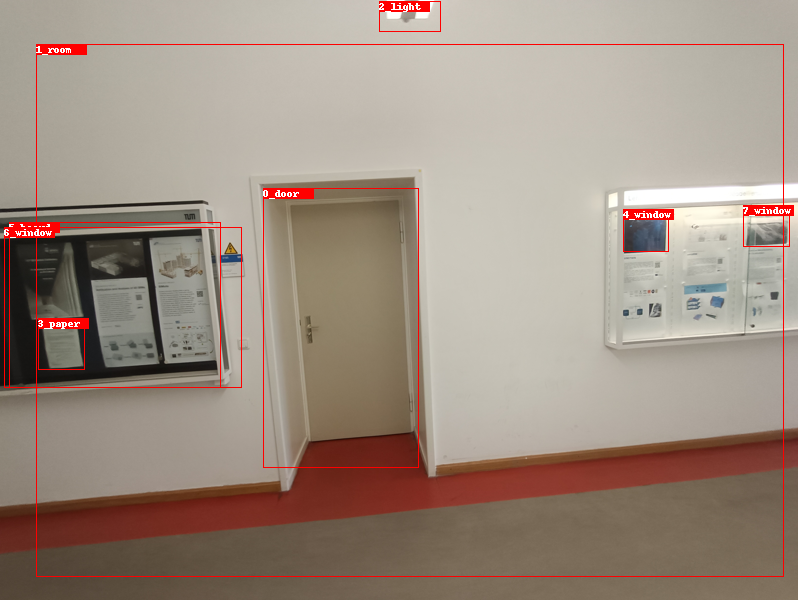

**************************************************
box_labels 0: door; score: 0.760985791683197
box_labels 1: room; score: 0.22242115437984467
box_labels 2: light; score: 0.21997147798538208
box_labels 3: paper; score: 0.18706060945987701
box_labels 4: window; score: 0.11371225863695145
box_labels 5: board; score: 0.08467700332403183
box_labels 6: window; score: 0.07554421573877335
box_labels 7: window; score: 0.0632292702794075
**************************************************
rel_labels 0: 1_room => has => 7_window; score: 0.7716038823127747
rel_labels 1: 1_room => has => 6_window; score: 0.7197161316871643
rel_labels 2: 5_board => in => 1_room; score: 0.6626205444335938
rel_labels 3: 1_room => has => 0_door; score: 0.622917652130127
rel_labels 4: 0_door => in => 1_room; score: 0.5910661220550537
rel_labels 5: 1_room => has => 2_light; score: 0.5785275101661682
rel_labels 6: 7_window => in => 1_room; score: 0.5712035894393921
rel_labels 7: 4_window => in => 1_room; score: 0.53064525

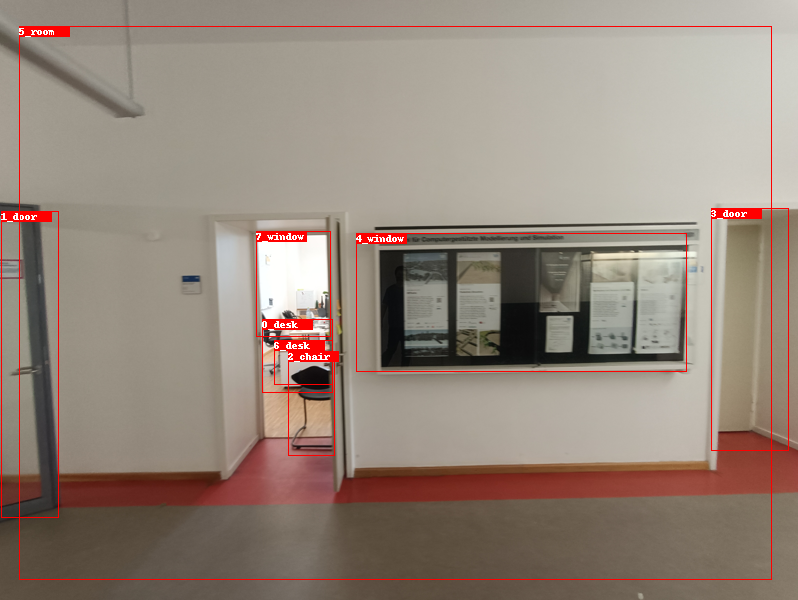

**************************************************
box_labels 0: desk; score: 0.7062029838562012
box_labels 1: door; score: 0.6286898851394653
box_labels 2: chair; score: 0.5505532622337341
box_labels 3: door; score: 0.4141654670238495
box_labels 4: window; score: 0.36709466576576233
box_labels 5: room; score: 0.35828250646591187
box_labels 6: desk; score: 0.29933562874794006
box_labels 7: window; score: 0.23524326086044312
**************************************************
rel_labels 0: 6_desk => in => 5_room; score: 0.9410256743431091
rel_labels 1: 0_desk => in => 5_room; score: 0.9277969002723694
rel_labels 2: 5_room => has => 3_door; score: 0.9128260016441345
rel_labels 3: 2_chair => in => 5_room; score: 0.883198618888855
rel_labels 4: 7_window => in => 5_room; score: 0.8597723841667175
rel_labels 5: 2_chair => at => 6_desk; score: 0.8274879455566406
rel_labels 6: 5_room => has => 1_door; score: 0.7892396450042725
rel_labels 7: 3_door => in => 5_room; score: 0.7873117327690125
rel_

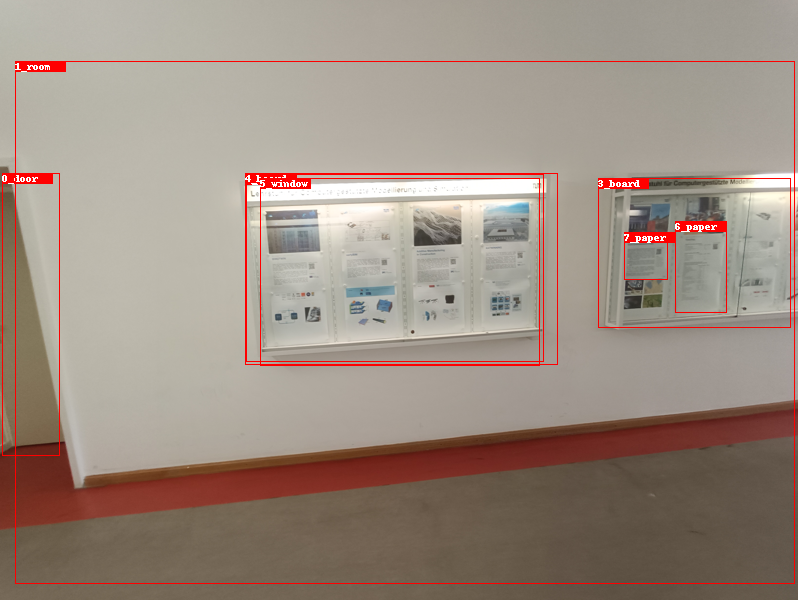

**************************************************
box_labels 0: door; score: 0.3567084074020386
box_labels 1: room; score: 0.1410621553659439
box_labels 2: screen; score: 0.11051300168037415
box_labels 3: board; score: 0.06366563588380814
box_labels 4: board; score: 0.047703489661216736
box_labels 5: window; score: 0.04381418973207474
box_labels 6: paper; score: 0.03260764852166176
box_labels 7: paper; score: 0.023861203342676163
**************************************************
rel_labels 0: 1_room => has => 0_door; score: 0.8152619004249573
rel_labels 1: 1_room => has => 3_board; score: 0.6640053987503052
rel_labels 2: 0_door => in => 1_room; score: 0.6520522832870483
rel_labels 3: 1_room => has => 7_paper; score: 0.5915939211845398
rel_labels 4: 4_board => in => 1_room; score: 0.5354177355766296
rel_labels 5: 3_board => with => 7_paper; score: 0.5351777076721191
rel_labels 6: 1_room => has => 6_paper; score: 0.5053966641426086
rel_labels 7: 5_window => has => 7_paper; score: 0.495

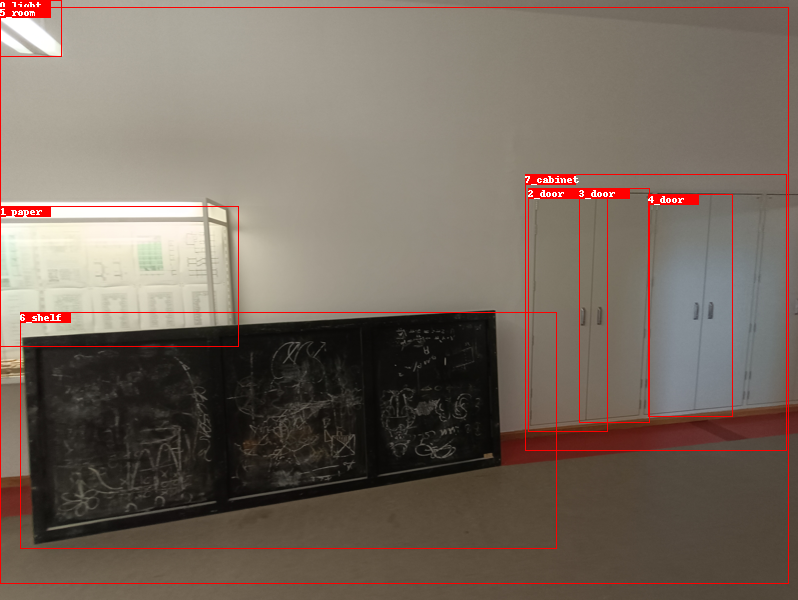

**************************************************
box_labels 0: light; score: 0.5981554388999939
box_labels 1: paper; score: 0.4040609896183014
box_labels 2: door; score: 0.40059617161750793
box_labels 3: door; score: 0.34263181686401367
box_labels 4: door; score: 0.2849107086658478
box_labels 5: room; score: 0.17260627448558807
box_labels 6: shelf; score: 0.16949105262756348
box_labels 7: cabinet; score: 0.16164879500865936
**************************************************
rel_labels 0: 5_room => has => 2_door; score: 0.9080343246459961
rel_labels 1: 5_room => has => 3_door; score: 0.8951208591461182
rel_labels 2: 5_room => has => 4_door; score: 0.8948853611946106
rel_labels 3: 6_shelf => in => 5_room; score: 0.7866217494010925
rel_labels 4: 5_room => has => 0_light; score: 0.7353938817977905
rel_labels 5: 7_cabinet => has => 2_door; score: 0.7137279510498047
rel_labels 6: 7_cabinet => has => 3_door; score: 0.6870721578598022
rel_labels 7: 6_shelf => has => 2_door; score: 0.68483936

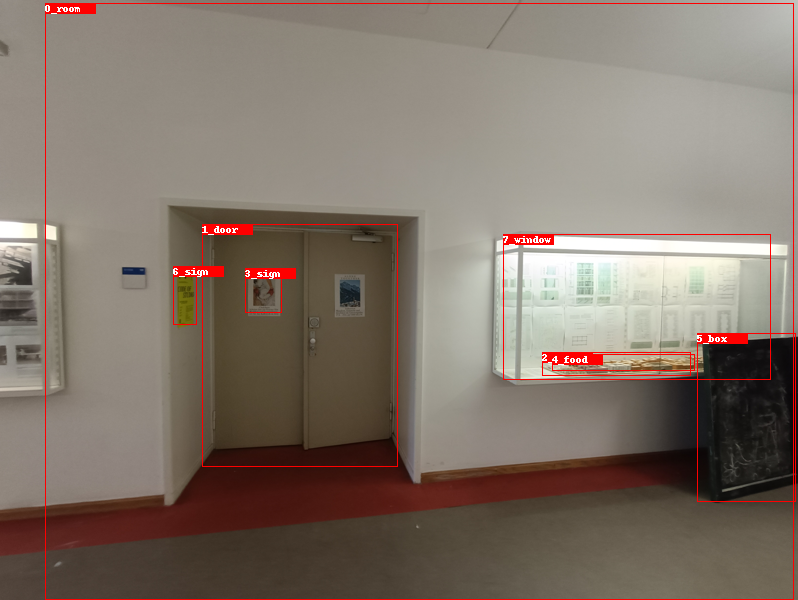

**************************************************
box_labels 0: room; score: 0.5177831053733826
box_labels 1: door; score: 0.5104276537895203
box_labels 2: pizza; score: 0.4268333911895752
box_labels 3: sign; score: 0.22135184705257416
box_labels 4: food; score: 0.16364894807338715
box_labels 5: box; score: 0.16357482969760895
box_labels 6: sign; score: 0.14571581780910492
box_labels 7: window; score: 0.12238869816064835
**************************************************
rel_labels 0: 0_room => has => 1_door; score: 0.86763596534729
rel_labels 1: 4_food => in => 0_room; score: 0.7964614033699036
rel_labels 2: 5_box => in => 0_room; score: 0.7800126075744629
rel_labels 3: 2_pizza => in => 0_room; score: 0.7797272205352783
rel_labels 4: 1_door => in => 0_room; score: 0.7604590058326721
rel_labels 5: 0_room => has => 7_window; score: 0.7493977546691895
rel_labels 6: 3_sign => in => 0_room; score: 0.6662734150886536
rel_labels 7: 6_sign => in => 0_room; score: 0.6632010340690613
rel_label

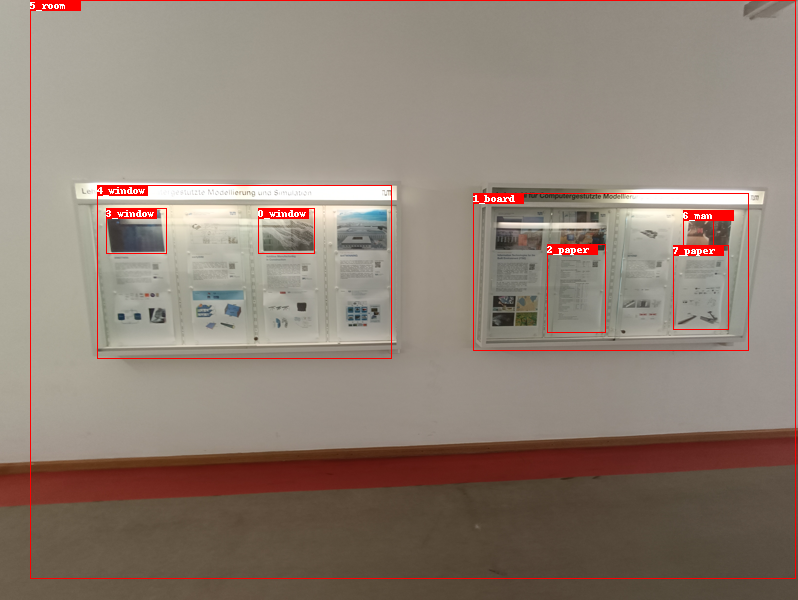

**************************************************
box_labels 0: window; score: 0.14486248791217804
box_labels 1: board; score: 0.1340910941362381
box_labels 2: paper; score: 0.09786611795425415
box_labels 3: window; score: 0.09471118450164795
box_labels 4: window; score: 0.04281771555542946
box_labels 5: room; score: 0.04074818268418312
box_labels 6: man; score: 0.03242097049951553
box_labels 7: paper; score: 0.029511339962482452
**************************************************
rel_labels 0: 0_window => in => 5_room; score: 0.6411771774291992
rel_labels 1: 5_room => has => 4_window; score: 0.628976047039032
rel_labels 2: 1_board => in => 5_room; score: 0.5874989032745361
rel_labels 3: 3_window => in => 5_room; score: 0.5131356716156006
rel_labels 4: 5_room => has => 3_window; score: 0.4774278700351715
rel_labels 5: 5_room => has => 7_paper; score: 0.47464579343795776
rel_labels 6: 6_man => standing on => 7_paper; score: 0.4733535647392273
rel_labels 7: 2_paper => in => 5_room; score

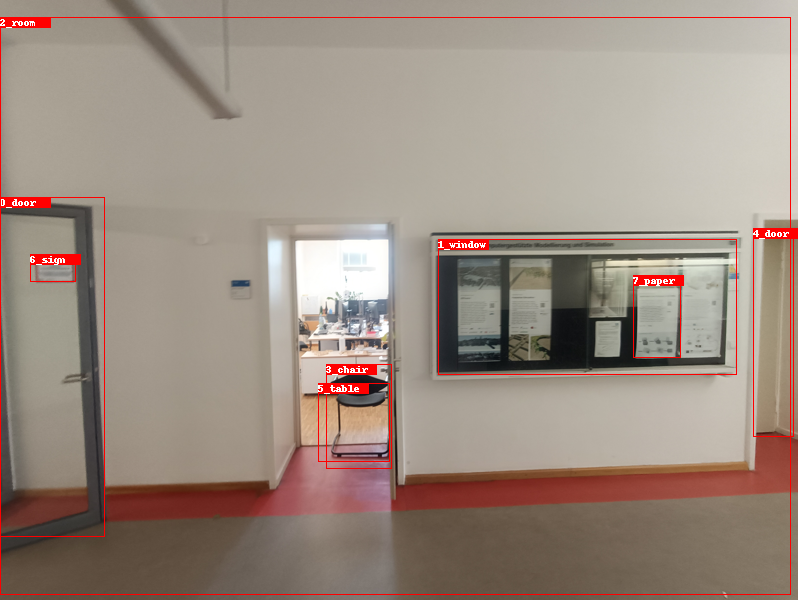

**************************************************
box_labels 0: door; score: 0.7233002781867981
box_labels 1: window; score: 0.4162931740283966
box_labels 2: room; score: 0.31233322620391846
box_labels 3: chair; score: 0.2903048098087311
box_labels 4: door; score: 0.28057608008384705
box_labels 5: table; score: 0.1820971816778183
box_labels 6: sign; score: 0.15361835062503815
box_labels 7: paper; score: 0.11329716444015503
**************************************************
rel_labels 0: 5_table => in => 2_room; score: 0.9502358436584473
rel_labels 1: 3_chair => in => 2_room; score: 0.9221025705337524
rel_labels 2: 2_room => has => 4_door; score: 0.8827690482139587
rel_labels 3: 4_door => in => 2_room; score: 0.7977159023284912
rel_labels 4: 2_room => has => 0_door; score: 0.7740921974182129
rel_labels 5: 1_window => in => 2_room; score: 0.7406630516052246
rel_labels 6: 7_paper => in => 2_room; score: 0.720215916633606
rel_labels 7: 0_door => in => 2_room; score: 0.7175580263137817
rel

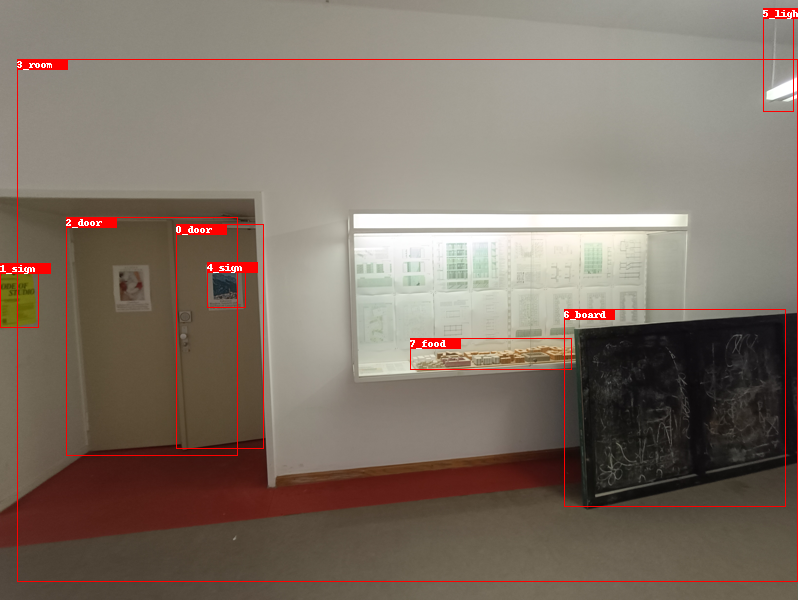

**************************************************
box_labels 0: door; score: 0.5915078520774841
box_labels 1: sign; score: 0.47286906838417053
box_labels 2: door; score: 0.4482172131538391
box_labels 3: room; score: 0.23964156210422516
box_labels 4: sign; score: 0.2029629945755005
box_labels 5: light; score: 0.172575443983078
box_labels 6: board; score: 0.16912397742271423
box_labels 7: food; score: 0.1514272540807724
**************************************************
rel_labels 0: 3_room => has => 0_door; score: 0.9048073291778564
rel_labels 1: 3_room => has => 2_door; score: 0.8490739464759827
rel_labels 2: 6_board => in => 3_room; score: 0.8176071643829346
rel_labels 3: 7_food => in => 3_room; score: 0.7631561160087585
rel_labels 4: 3_room => has => 5_light; score: 0.6893738508224487
rel_labels 5: 3_room => has => 4_sign; score: 0.6837653517723083
rel_labels 6: 5_light => above => 6_board; score: 0.6683230996131897
rel_labels 7: 0_door => in => 3_room; score: 0.6333728432655334
rel

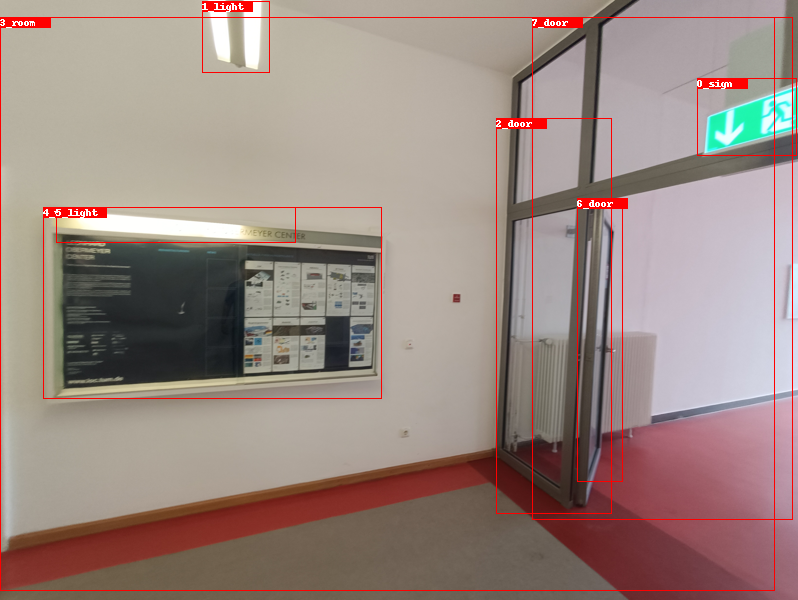

**************************************************
box_labels 0: sign; score: 0.7548938989639282
box_labels 1: light; score: 0.4977642595767975
box_labels 2: door; score: 0.3747973144054413
box_labels 3: room; score: 0.3598743677139282
box_labels 4: window; score: 0.26965492963790894
box_labels 5: light; score: 0.13948382437229156
box_labels 6: door; score: 0.12457934021949768
box_labels 7: door; score: 0.08123913407325745
**************************************************
rel_labels 0: 3_room => has => 6_door; score: 0.8903355598449707
rel_labels 1: 7_door => has => 6_door; score: 0.8110100626945496
rel_labels 2: 3_room => has => 2_door; score: 0.7829844951629639
rel_labels 3: 2_door => in => 3_room; score: 0.777186393737793
rel_labels 4: 7_door => in => 3_room; score: 0.7651095390319824
rel_labels 5: 3_room => has => 4_window; score: 0.7645055055618286
rel_labels 6: 3_room => has => 1_light; score: 0.7084630727767944
rel_labels 7: 4_window => in => 3_room; score: 0.6845282316207886
r

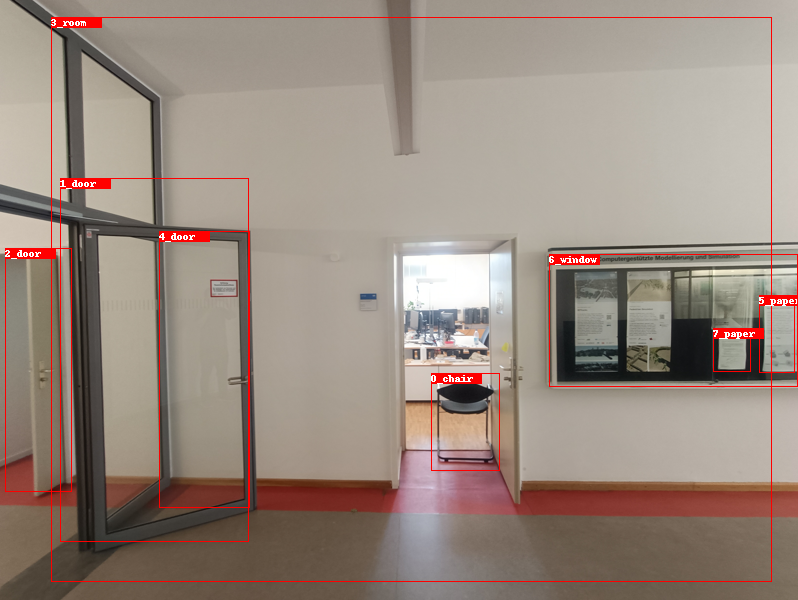

**************************************************
box_labels 0: chair; score: 0.6272242665290833
box_labels 1: door; score: 0.4399198591709137
box_labels 2: door; score: 0.42345377802848816
box_labels 3: room; score: 0.32570862770080566
box_labels 4: door; score: 0.30920687317848206
box_labels 5: paper; score: 0.2613241672515869
box_labels 6: window; score: 0.24697349965572357
box_labels 7: paper; score: 0.15963687002658844
**************************************************
rel_labels 0: 3_room => has => 2_door; score: 0.9313732981681824
rel_labels 1: 0_chair => in => 3_room; score: 0.9067327380180359
rel_labels 2: 3_room => has => 4_door; score: 0.7940752506256104
rel_labels 3: 1_door => in => 3_room; score: 0.7864392995834351
rel_labels 4: 3_room => has => 6_window; score: 0.7835074663162231
rel_labels 5: 2_door => in => 3_room; score: 0.7740658521652222
rel_labels 6: 4_door => in => 3_room; score: 0.7361137866973877
rel_labels 7: 3_room => has => 1_door; score: 0.7327767014503479
r

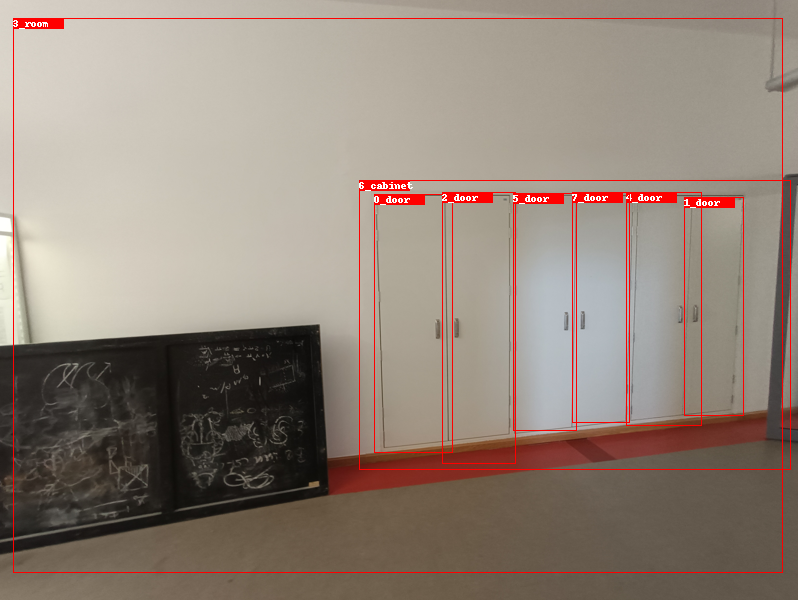

**************************************************
box_labels 0: door; score: 0.5426401495933533
box_labels 1: door; score: 0.40408727526664734
box_labels 2: door; score: 0.3611932694911957
box_labels 3: room; score: 0.32327309250831604
box_labels 4: door; score: 0.3143320083618164
box_labels 5: door; score: 0.28111177682876587
box_labels 6: cabinet; score: 0.23038756847381592
box_labels 7: door; score: 0.19926798343658447
**************************************************
rel_labels 0: 3_room => has => 1_door; score: 0.9132959842681885
rel_labels 1: 3_room => has => 4_door; score: 0.8829240202903748
rel_labels 2: 3_room => has => 7_door; score: 0.8819493055343628
rel_labels 3: 3_room => has => 5_door; score: 0.8515021204948425
rel_labels 4: 3_room => has => 2_door; score: 0.8514673709869385
rel_labels 5: 3_room => has => 0_door; score: 0.8372822999954224
rel_labels 6: 6_cabinet => has => 1_door; score: 0.6964788436889648
rel_labels 7: 6_cabinet => has => 4_door; score: 0.6875964999198

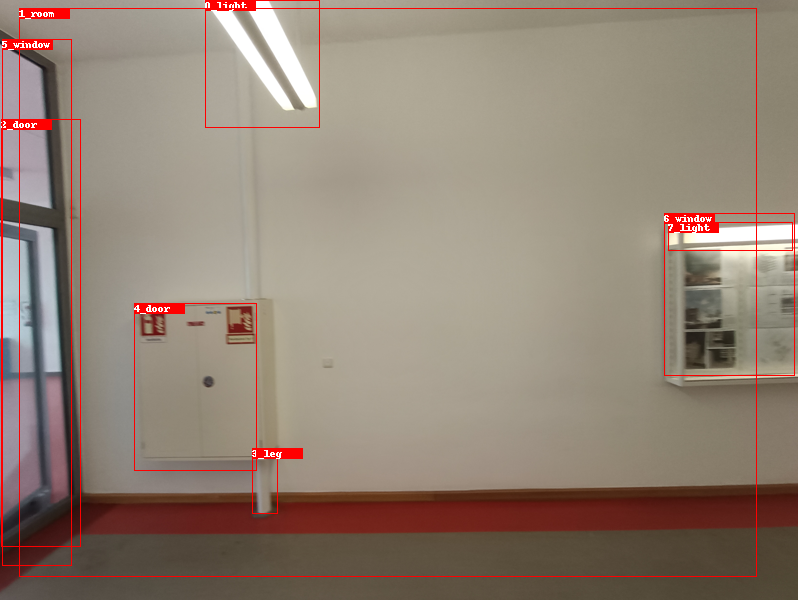

**************************************************
box_labels 0: light; score: 0.7452160716056824
box_labels 1: room; score: 0.4796605110168457
box_labels 2: door; score: 0.2680228352546692
box_labels 3: leg; score: 0.26013991236686707
box_labels 4: door; score: 0.24508674442768097
box_labels 5: window; score: 0.1978832632303238
box_labels 6: window; score: 0.16678303480148315
box_labels 7: light; score: 0.12936735153198242
**************************************************
rel_labels 0: 1_room => has => 4_door; score: 0.893510103225708
rel_labels 1: 1_room => has => 6_window; score: 0.8706466555595398
rel_labels 2: 1_room => has => 3_leg; score: 0.8636950850486755
rel_labels 3: 1_room => has => 7_light; score: 0.7553847432136536
rel_labels 4: 1_room => has => 0_light; score: 0.7369018793106079
rel_labels 5: 2_door => in => 1_room; score: 0.6900110840797424
rel_labels 6: 1_room => has => 5_window; score: 0.673332691192627
rel_labels 7: 1_room => has => 2_door; score: 0.6644060611724854

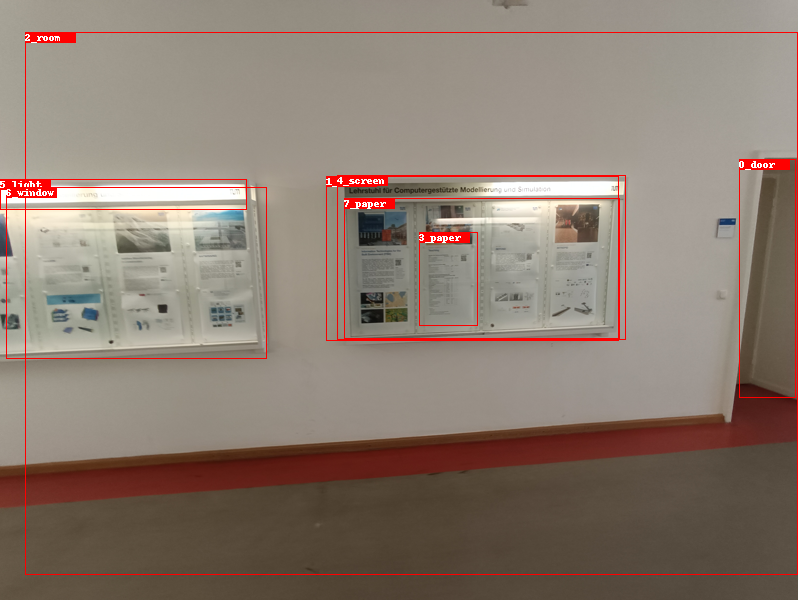

**************************************************
box_labels 0: door; score: 0.3592684268951416
box_labels 1: board; score: 0.1915471851825714
box_labels 2: room; score: 0.11570525914430618
box_labels 3: paper; score: 0.09278511255979538
box_labels 4: screen; score: 0.05096317082643509
box_labels 5: light; score: 0.04508448764681816
box_labels 6: window; score: 0.04436161741614342
box_labels 7: paper; score: 0.03435751795768738
**************************************************
rel_labels 0: 2_room => has => 0_door; score: 0.9012210369110107
rel_labels 1: 2_room => has => 6_window; score: 0.7721514105796814
rel_labels 2: 0_door => in => 2_room; score: 0.6518356204032898
rel_labels 3: 1_board => in => 2_room; score: 0.6133061647415161
rel_labels 4: 7_paper => in => 2_room; score: 0.5729694366455078
rel_labels 5: 2_room => has => 5_light; score: 0.547971248626709
rel_labels 6: 4_screen => in => 2_room; score: 0.5296878218650818
rel_labels 7: 4_screen => has => 3_paper; score: 0.48847115

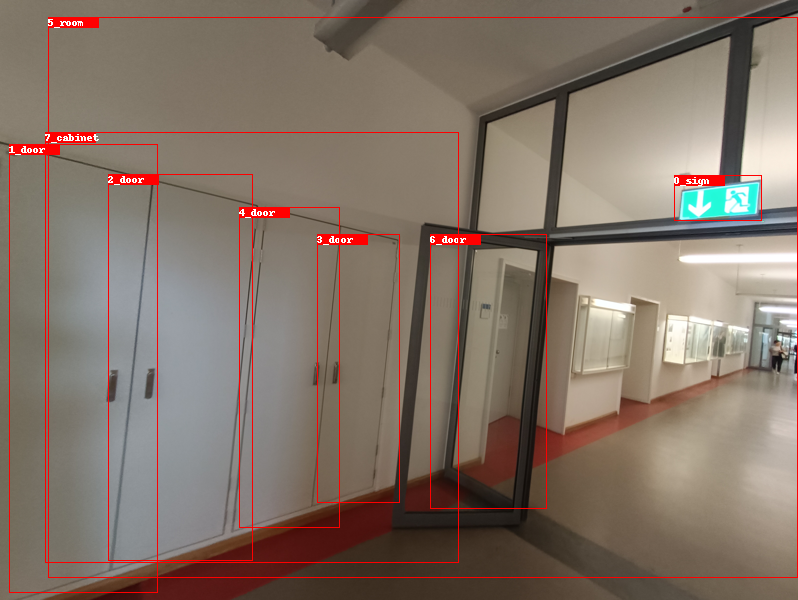

**************************************************
box_labels 0: sign; score: 0.5638411045074463
box_labels 1: door; score: 0.4701661169528961
box_labels 2: door; score: 0.41311126947402954
box_labels 3: door; score: 0.361004501581192
box_labels 4: door; score: 0.3446791172027588
box_labels 5: room; score: 0.3204173147678375
box_labels 6: door; score: 0.2900025546550751
box_labels 7: cabinet; score: 0.12477973103523254
**************************************************
rel_labels 0: 5_room => has => 2_door; score: 0.9034779071807861
rel_labels 1: 5_room => has => 3_door; score: 0.8521041870117188
rel_labels 2: 5_room => has => 4_door; score: 0.8319471478462219
rel_labels 3: 5_room => has => 1_door; score: 0.8214567303657532
rel_labels 4: 5_room => has => 6_door; score: 0.7964897751808167
rel_labels 5: 7_cabinet => has => 2_door; score: 0.794283390045166
rel_labels 6: 7_cabinet => in => 5_room; score: 0.7860117554664612
rel_labels 7: 6_door => in => 5_room; score: 0.7425355315208435
rel

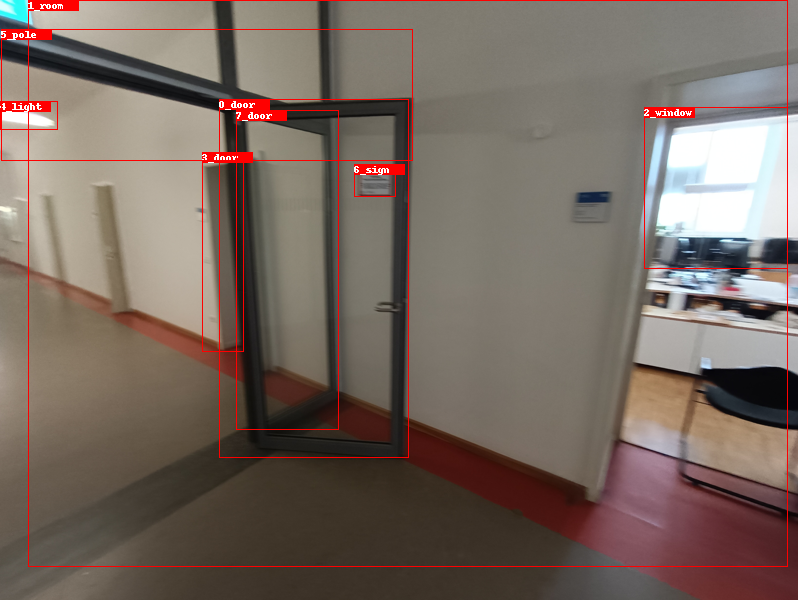

**************************************************
box_labels 0: door; score: 0.711888313293457
box_labels 1: room; score: 0.3966527581214905
box_labels 2: window; score: 0.37401777505874634
box_labels 3: door; score: 0.16060014069080353
box_labels 4: light; score: 0.12371009588241577
box_labels 5: pole; score: 0.09510340541601181
box_labels 6: sign; score: 0.07990522682666779
box_labels 7: door; score: 0.0788765624165535
**************************************************
rel_labels 0: 1_room => has => 7_door; score: 0.7759467363357544
rel_labels 1: 1_room => has => 3_door; score: 0.7702797055244446
rel_labels 2: 2_window => in => 1_room; score: 0.7688467502593994
rel_labels 3: 1_room => has => 0_door; score: 0.7317060232162476
rel_labels 4: 1_room => has => 5_pole; score: 0.718046247959137
rel_labels 5: 1_room => has => 2_window; score: 0.6843357682228088
rel_labels 6: 1_room => has => 4_light; score: 0.6793777942657471
rel_labels 7: 4_light => in => 1_room; score: 0.6514019966125488


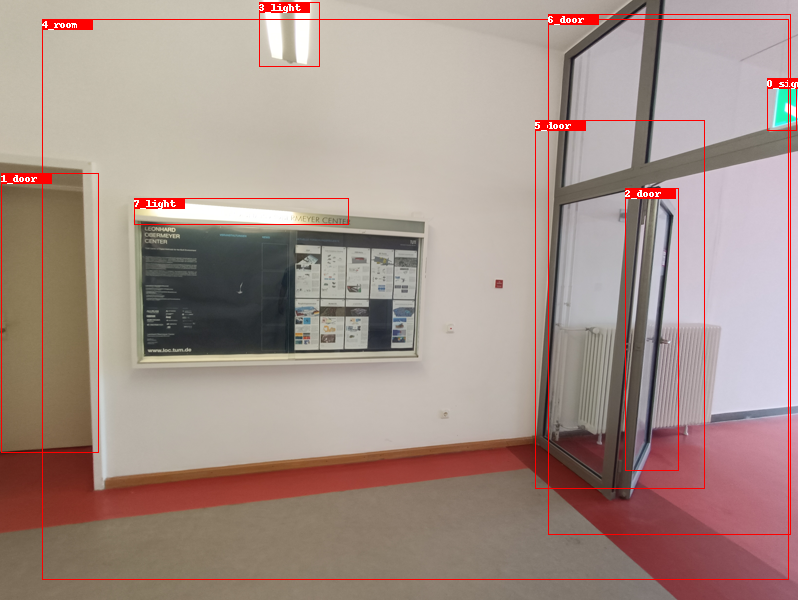

**************************************************
box_labels 0: sign; score: 0.6188666224479675
box_labels 1: door; score: 0.4794415235519409
box_labels 2: door; score: 0.46322694420814514
box_labels 3: light; score: 0.43473342061042786
box_labels 4: room; score: 0.40110260248184204
box_labels 5: door; score: 0.327297180891037
box_labels 6: door; score: 0.18102872371673584
box_labels 7: light; score: 0.17089182138442993
**************************************************
rel_labels 0: 4_room => has => 2_door; score: 0.8926318883895874
rel_labels 1: 6_door => has => 2_door; score: 0.841200590133667
rel_labels 2: 4_room => has => 1_door; score: 0.8021737933158875
rel_labels 3: 6_door => in => 4_room; score: 0.7731728553771973
rel_labels 4: 1_door => in => 4_room; score: 0.7714133262634277
rel_labels 5: 5_door => has => 2_door; score: 0.770196259021759
rel_labels 6: 4_room => has => 3_light; score: 0.741447389125824
rel_labels 7: 5_door => in => 4_room; score: 0.7377728819847107
rel_label

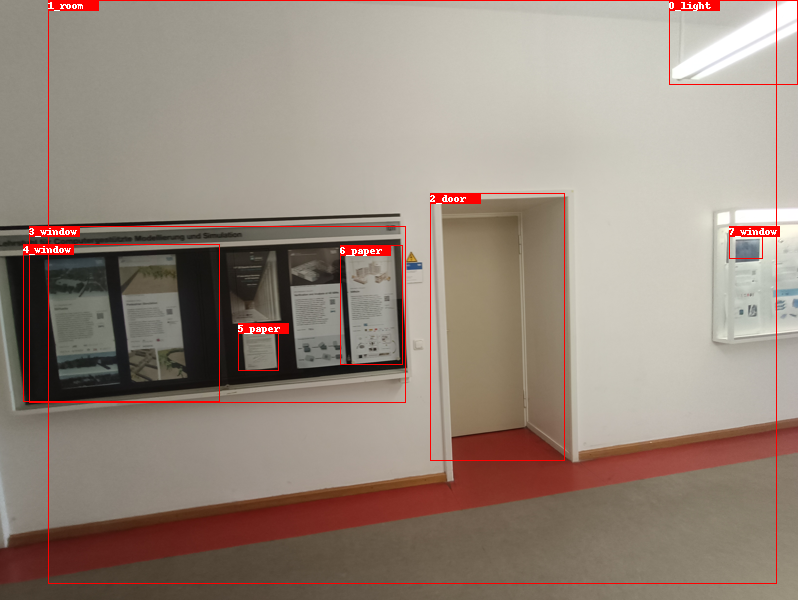

**************************************************
box_labels 0: light; score: 0.5760361552238464
box_labels 1: room; score: 0.3804381787776947
box_labels 2: door; score: 0.3192862570285797
box_labels 3: window; score: 0.1978951394557953
box_labels 4: window; score: 0.11998987197875977
box_labels 5: paper; score: 0.09430644661188126
box_labels 6: paper; score: 0.05416474491357803
box_labels 7: window; score: 0.05271260440349579
**************************************************
rel_labels 0: 1_room => has => 2_door; score: 0.8483875393867493
rel_labels 1: 2_door => in => 1_room; score: 0.7330023646354675
rel_labels 2: 4_window => in => 1_room; score: 0.7317329049110413
rel_labels 3: 1_room => has => 0_light; score: 0.7280135750770569
rel_labels 4: 1_room => has => 3_window; score: 0.7224595546722412
rel_labels 5: 1_room => has => 4_window; score: 0.7125403881072998
rel_labels 6: 3_window => in => 1_room; score: 0.6218860149383545
rel_labels 7: 1_room => has => 7_window; score: 0.599963

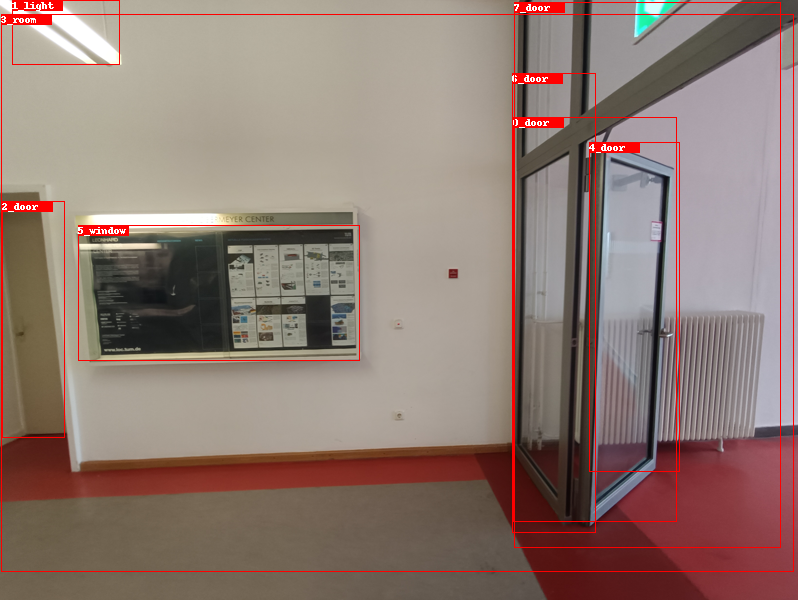

**************************************************
box_labels 0: door; score: 0.6402025818824768
box_labels 1: light; score: 0.6031690239906311
box_labels 2: door; score: 0.4796275198459625
box_labels 3: room; score: 0.33557501435279846
box_labels 4: door; score: 0.3022322654724121
box_labels 5: window; score: 0.1727910041809082
box_labels 6: door; score: 0.1588793843984604
box_labels 7: door; score: 0.12849080562591553
**************************************************
rel_labels 0: 3_room => has => 2_door; score: 0.9301986694335938
rel_labels 1: 3_room => has => 4_door; score: 0.8231822848320007
rel_labels 2: 3_room => has => 6_door; score: 0.7985763549804688
rel_labels 3: 3_room => has => 0_door; score: 0.7671368718147278
rel_labels 4: 3_room => has => 5_window; score: 0.7593086361885071
rel_labels 5: 2_door => in => 3_room; score: 0.7580231428146362
rel_labels 6: 3_room => has => 1_light; score: 0.7384338974952698
rel_labels 7: 7_door => in => 3_room; score: 0.7216426730155945
rel_

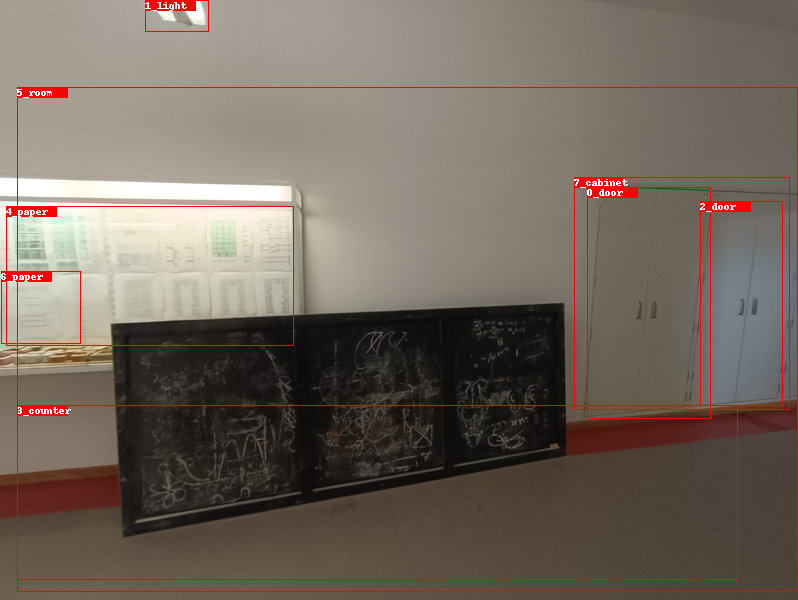

**************************************************
box_labels 0: door; score: 0.5787861943244934
box_labels 1: light; score: 0.3069097101688385
box_labels 2: door; score: 0.30469775199890137
box_labels 3: counter; score: 0.21752174198627472
box_labels 4: paper; score: 0.1574079990386963
box_labels 5: room; score: 0.14580197632312775
box_labels 6: paper; score: 0.12455016374588013
box_labels 7: cabinet; score: 0.09922938793897629
**************************************************
rel_labels 0: 5_room => has => 2_door; score: 0.895022451877594
rel_labels 1: 5_room => has => 0_door; score: 0.8644468784332275
rel_labels 2: 3_counter => has => 2_door; score: 0.8239279985427856
rel_labels 3: 3_counter => has => 0_door; score: 0.7917391061782837
rel_labels 4: 7_cabinet => has => 2_door; score: 0.7467435002326965
rel_labels 5: 7_cabinet => has => 0_door; score: 0.7141271829605103
rel_labels 6: 1_light => above => 3_counter; score: 0.7086156010627747
rel_labels 7: 5_room => has => 1_light; scor

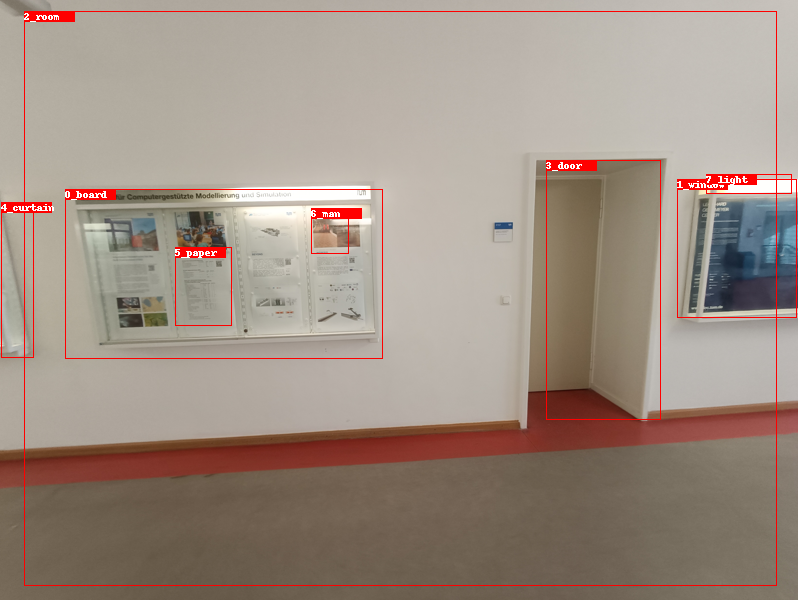

**************************************************
box_labels 0: board; score: 0.403670996427536
box_labels 1: window; score: 0.360992431640625
box_labels 2: room; score: 0.2070474475622177
box_labels 3: door; score: 0.184895321726799
box_labels 4: curtain; score: 0.08080121874809265
box_labels 5: paper; score: 0.06194636598229408
box_labels 6: man; score: 0.03414444997906685
box_labels 7: light; score: 0.0317879356443882
**************************************************
rel_labels 0: 2_room => has => 3_door; score: 0.7934441566467285
rel_labels 1: 2_room => has => 1_window; score: 0.7775885462760925
rel_labels 2: 2_room => has => 4_curtain; score: 0.6846286058425903
rel_labels 3: 0_board => in => 2_room; score: 0.6599099636077881
rel_labels 4: 2_room => has => 7_light; score: 0.6042985916137695
rel_labels 5: 1_window => in => 2_room; score: 0.5981376767158508
rel_labels 6: 3_door => in => 2_room; score: 0.5791256427764893
rel_labels 7: 2_room => has => 0_board; score: 0.5383625626564

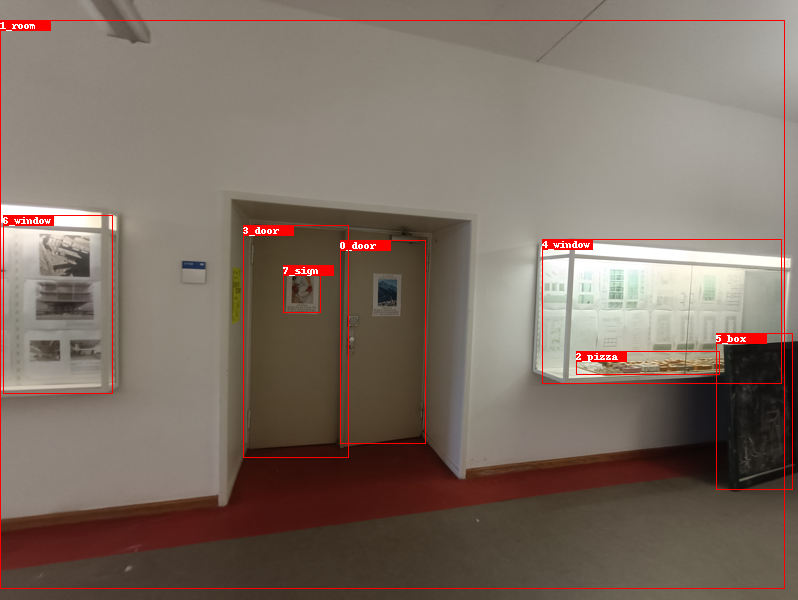

**************************************************
box_labels 0: door; score: 0.669485330581665
box_labels 1: room; score: 0.519903838634491
box_labels 2: pizza; score: 0.5188111066818237
box_labels 3: door; score: 0.3295367658138275
box_labels 4: window; score: 0.24396230280399323
box_labels 5: box; score: 0.178429514169693
box_labels 6: window; score: 0.144526869058609
box_labels 7: sign; score: 0.13967929780483246
**************************************************
rel_labels 0: 1_room => has => 0_door; score: 0.924716591835022
rel_labels 1: 1_room => has => 3_door; score: 0.8810034990310669
rel_labels 2: 1_room => has => 6_window; score: 0.8129580020904541
rel_labels 3: 3_door => in => 1_room; score: 0.8072513937950134
rel_labels 4: 0_door => in => 1_room; score: 0.7777772545814514
rel_labels 5: 6_window => in => 1_room; score: 0.7750484943389893
rel_labels 6: 5_box => in => 1_room; score: 0.7611891627311707
rel_labels 7: 1_room => has => 4_window; score: 0.7568751573562622
rel_labe

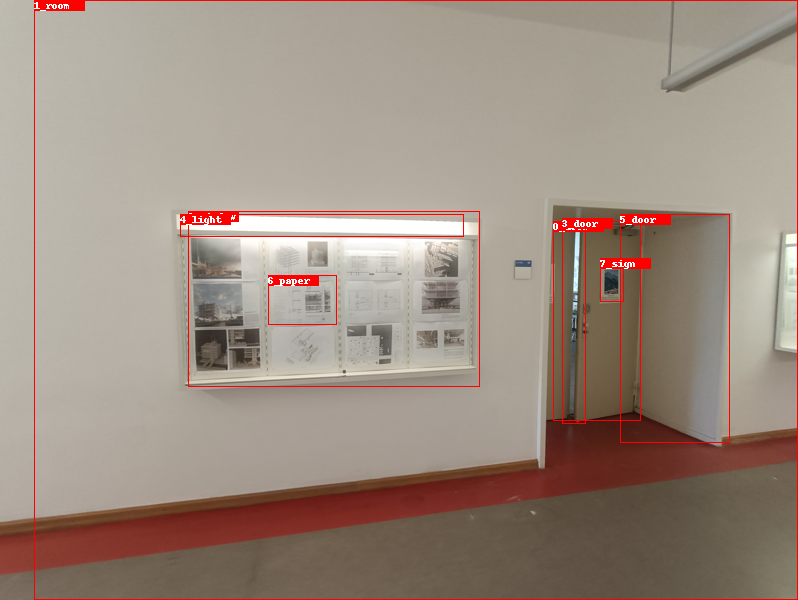

**************************************************
box_labels 0: door; score: 0.4998229146003723
box_labels 1: room; score: 0.4617803990840912
box_labels 2: window; score: 0.4233788251876831
box_labels 3: door; score: 0.3908068835735321
box_labels 4: light; score: 0.2607952356338501
box_labels 5: door; score: 0.07480208575725555
box_labels 6: paper; score: 0.05311032757163048
box_labels 7: sign; score: 0.030565457418560982
**************************************************
rel_labels 0: 1_room => has => 3_door; score: 0.9214784502983093
rel_labels 1: 1_room => has => 0_door; score: 0.9146137833595276
rel_labels 2: 1_room => has => 5_door; score: 0.8748887181282043
rel_labels 3: 1_room => has => 7_sign; score: 0.7354946732521057
rel_labels 4: 0_door => in => 1_room; score: 0.734845757484436
rel_labels 5: 5_door => in => 1_room; score: 0.7180529236793518
rel_labels 6: 1_room => has => 2_window; score: 0.7048036456108093
rel_labels 7: 3_door => in => 1_room; score: 0.7044623494148254
rel_

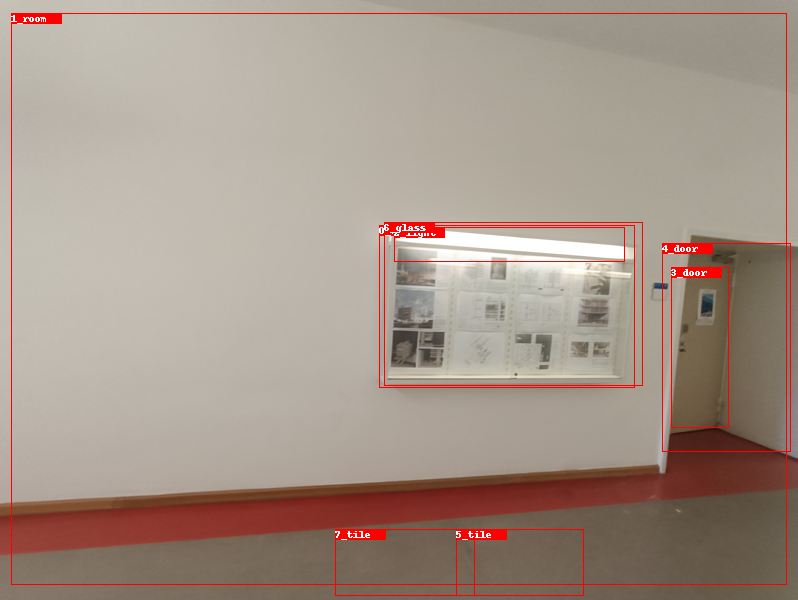

**************************************************
box_labels 0: window; score: 0.4370841085910797
box_labels 1: room; score: 0.23856934905052185
box_labels 2: light; score: 0.23154692351818085
box_labels 3: door; score: 0.10291223227977753
box_labels 4: door; score: 0.07544133067131042
box_labels 5: tile; score: 0.05567362904548645
box_labels 6: glass; score: 0.03500564396381378
box_labels 7: tile; score: 0.03243819251656532
**************************************************
rel_labels 0: 1_room => has => 3_door; score: 0.9251871705055237
rel_labels 1: 1_room => has => 4_door; score: 0.8468747138977051
rel_labels 2: 5_tile => under => 2_light; score: 0.8056692481040955
rel_labels 3: 7_tile => under => 2_light; score: 0.8052640557289124
rel_labels 4: 1_room => has => 0_window; score: 0.7732177376747131
rel_labels 5: 7_tile => under => 6_glass; score: 0.665209174156189
rel_labels 6: 1_room => has => 2_light; score: 0.6577734351158142
rel_labels 7: 5_tile => under => 6_glass; score: 0.63

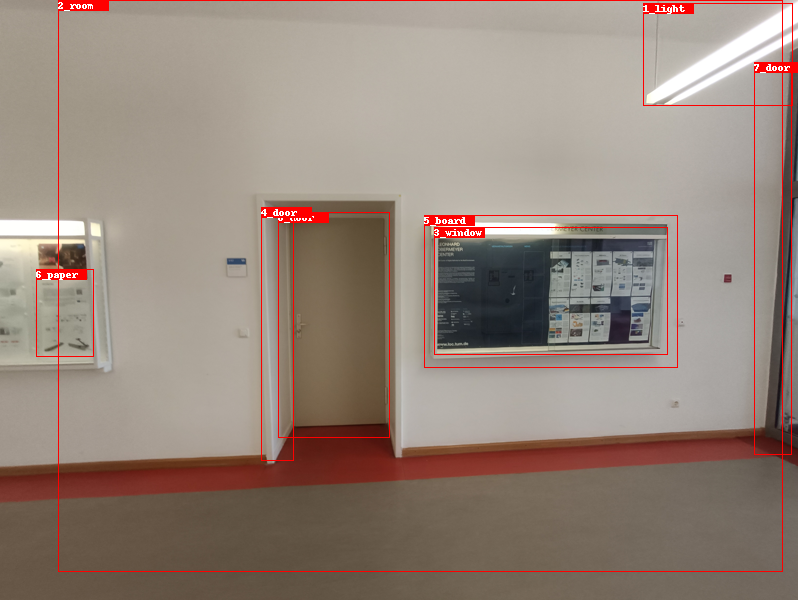

**************************************************
box_labels 0: door; score: 0.6498651504516602
box_labels 1: light; score: 0.5782768726348877
box_labels 2: room; score: 0.319731742143631
box_labels 3: window; score: 0.0939064472913742
box_labels 4: door; score: 0.0545627698302269
box_labels 5: board; score: 0.0494377426803112
box_labels 6: paper; score: 0.043469615280628204
box_labels 7: door; score: 0.042189426720142365
**************************************************
rel_labels 0: 2_room => has => 4_door; score: 0.8907542824745178
rel_labels 1: 2_room => has => 0_door; score: 0.8373969197273254
rel_labels 2: 2_room => has => 7_door; score: 0.7949400544166565
rel_labels 3: 2_room => has => 3_window; score: 0.7627200484275818
rel_labels 4: 5_board => in => 2_room; score: 0.7440437078475952
rel_labels 5: 7_door => in => 2_room; score: 0.7371681928634644
rel_labels 6: 0_door => in => 2_room; score: 0.7301861643791199
rel_labels 7: 0_door => has => 4_door; score: 0.7067755460739136
re

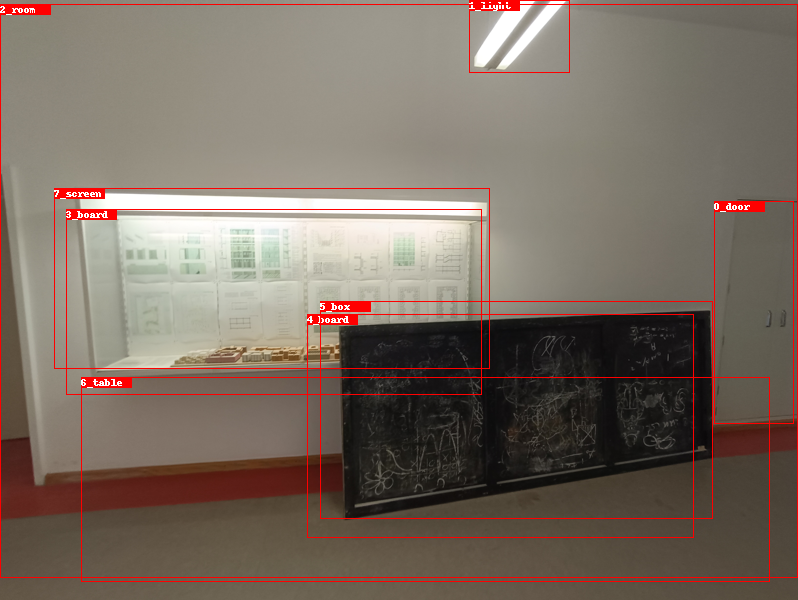

**************************************************
box_labels 0: door; score: 0.6916474103927612
box_labels 1: light; score: 0.6819623708724976
box_labels 2: room; score: 0.22526592016220093
box_labels 3: board; score: 0.1518477201461792
box_labels 4: board; score: 0.13999879360198975
box_labels 5: box; score: 0.08627510815858841
box_labels 6: table; score: 0.07450927048921585
box_labels 7: screen; score: 0.07141553610563278
**************************************************
rel_labels 0: 2_room => has => 0_door; score: 0.9020059108734131
rel_labels 1: 6_table => has => 0_door; score: 0.8080657124519348
rel_labels 2: 4_board => in => 2_room; score: 0.7937923073768616
rel_labels 3: 6_table => in => 2_room; score: 0.7752494812011719
rel_labels 4: 1_light => above => 4_board; score: 0.7553887963294983
rel_labels 5: 3_board => in => 2_room; score: 0.7516357898712158
rel_labels 6: 2_room => has => 1_light; score: 0.7273296117782593
rel_labels 7: 1_light => above => 6_table; score: 0.7104340

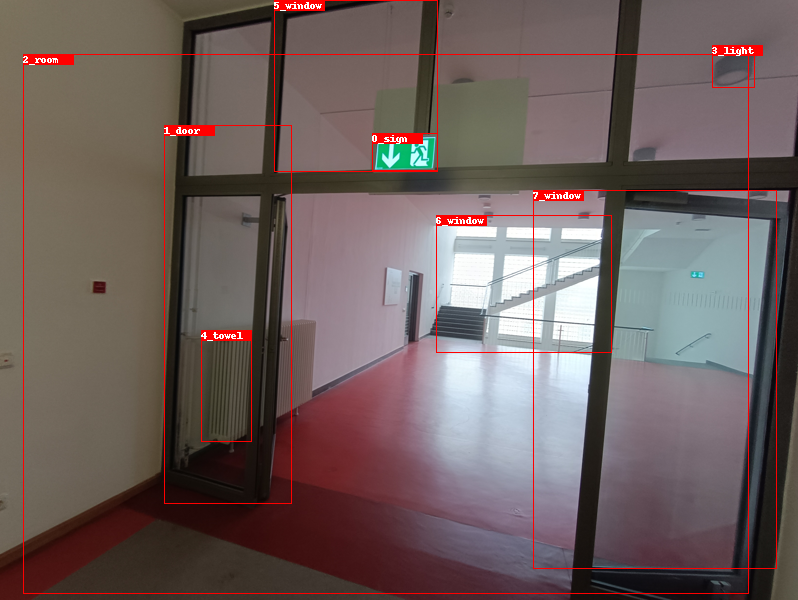

**************************************************
box_labels 0: sign; score: 0.423832505941391
box_labels 1: door; score: 0.27180856466293335
box_labels 2: room; score: 0.2449292093515396
box_labels 3: light; score: 0.2250625044107437
box_labels 4: towel; score: 0.09420306235551834
box_labels 5: window; score: 0.08982488512992859
box_labels 6: window; score: 0.07473751157522202
box_labels 7: window; score: 0.06439947336912155
**************************************************
rel_labels 0: 6_window => in => 2_room; score: 0.704436719417572
rel_labels 1: 2_room => has => 3_light; score: 0.7026533484458923
rel_labels 2: 1_door => in => 2_room; score: 0.7025148272514343
rel_labels 3: 2_room => has => 5_window; score: 0.6720136404037476
rel_labels 4: 7_window => in => 2_room; score: 0.6614260673522949
rel_labels 5: 5_window => in => 2_room; score: 0.6433064341545105
rel_labels 6: 4_towel => in => 2_room; score: 0.5875714421272278
rel_labels 7: 2_room => has => 6_window; score: 0.555894136

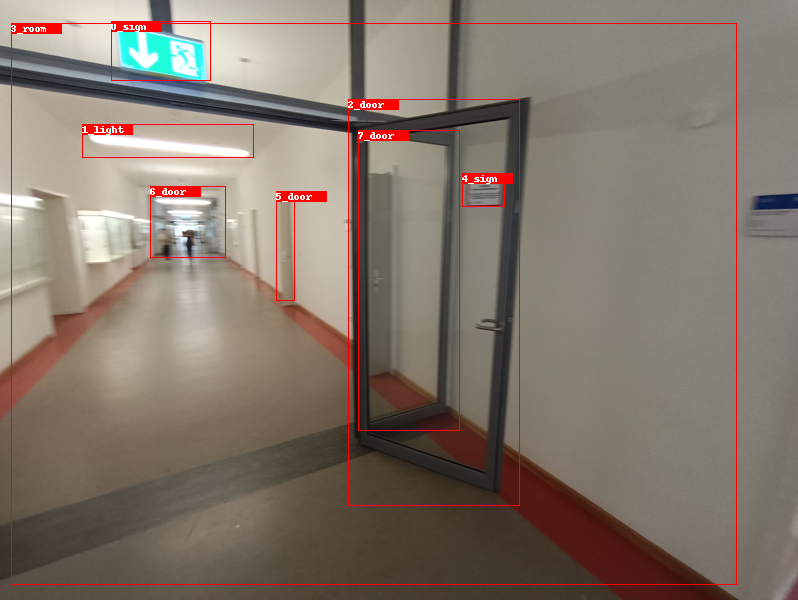

**************************************************
box_labels 0: sign; score: 0.5751492381095886
box_labels 1: light; score: 0.4827481210231781
box_labels 2: door; score: 0.46237486600875854
box_labels 3: room; score: 0.36536917090415955
box_labels 4: sign; score: 0.19765973091125488
box_labels 5: door; score: 0.14878785610198975
box_labels 6: door; score: 0.10104788094758987
box_labels 7: door; score: 0.08302314579486847
**************************************************
rel_labels 0: 3_room => has => 5_door; score: 0.8969582915306091
rel_labels 1: 3_room => has => 6_door; score: 0.8692911267280579
rel_labels 2: 3_room => has => 7_door; score: 0.7750886678695679
rel_labels 3: 3_room => has => 2_door; score: 0.7503544688224792
rel_labels 4: 7_door => in => 3_room; score: 0.6570922136306763
rel_labels 5: 2_door => in => 3_room; score: 0.6208637356758118
rel_labels 6: 3_room => has => 1_light; score: 0.61178058385849
rel_labels 7: 5_door => in => 3_room; score: 0.5582564473152161
rel_lab

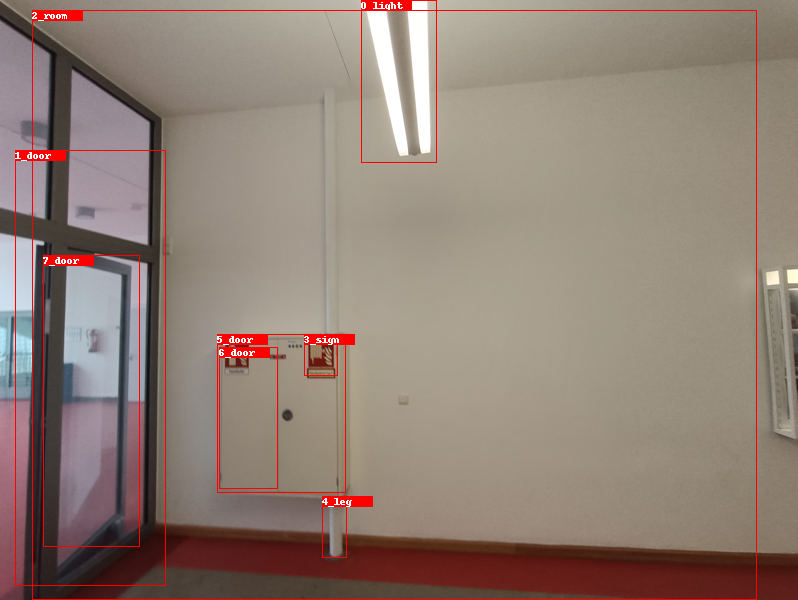

**************************************************
box_labels 0: light; score: 0.6478453278541565
box_labels 1: door; score: 0.5261721014976501
box_labels 2: room; score: 0.5024721026420593
box_labels 3: sign; score: 0.3774367570877075
box_labels 4: leg; score: 0.3504634499549866
box_labels 5: door; score: 0.32258307933807373
box_labels 6: door; score: 0.13541078567504883
box_labels 7: door; score: 0.12729743123054504
**************************************************
rel_labels 0: 2_room => has => 5_door; score: 0.9111631512641907
rel_labels 1: 2_room => has => 6_door; score: 0.8922584652900696
rel_labels 2: 2_room => has => 4_leg; score: 0.7946804761886597
rel_labels 3: 2_room => has => 7_door; score: 0.7810783386230469
rel_labels 4: 2_room => has => 0_light; score: 0.7405710816383362
rel_labels 5: 1_door => has => 6_door; score: 0.7059749364852905
rel_labels 6: 1_door => has => 4_leg; score: 0.6751033067703247
rel_labels 7: 2_room => has => 1_door; score: 0.6399334073066711
rel_labe

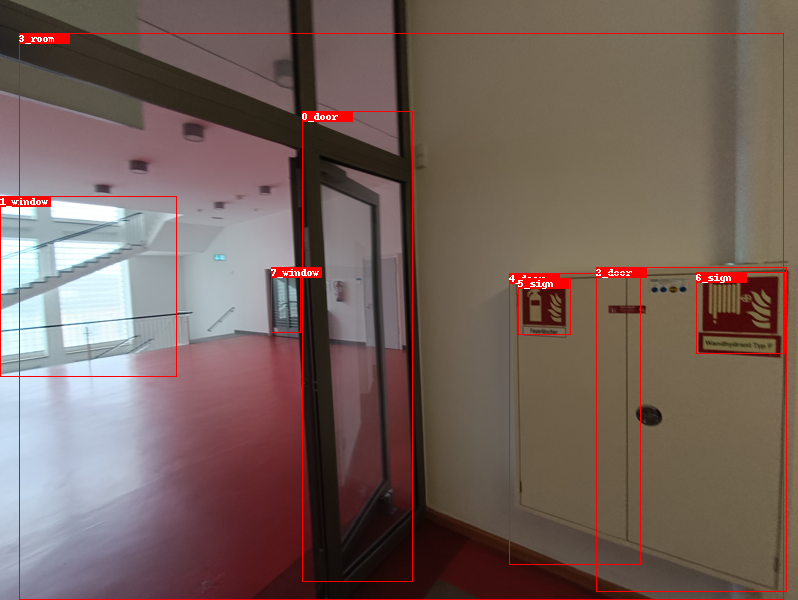

**************************************************
box_labels 0: door; score: 0.5802204012870789
box_labels 1: window; score: 0.49247151613235474
box_labels 2: door; score: 0.4688403010368347
box_labels 3: room; score: 0.4563404619693756
box_labels 4: door; score: 0.38047194480895996
box_labels 5: sign; score: 0.3468676507472992
box_labels 6: sign; score: 0.25429320335388184
box_labels 7: window; score: 0.20256249606609344
**************************************************
rel_labels 0: 3_room => has => 2_door; score: 0.93522047996521
rel_labels 1: 3_room => has => 4_door; score: 0.9004433751106262
rel_labels 2: 3_room => has => 7_window; score: 0.8859924077987671
rel_labels 3: 3_room => has => 0_door; score: 0.8492342233657837
rel_labels 4: 3_room => has => 1_window; score: 0.8032297492027283
rel_labels 5: 3_room => has => 5_sign; score: 0.73307865858078
rel_labels 6: 3_room => has => 6_sign; score: 0.7294473052024841
rel_labels 7: 2_door => in => 3_room; score: 0.69632488489151
rel_l

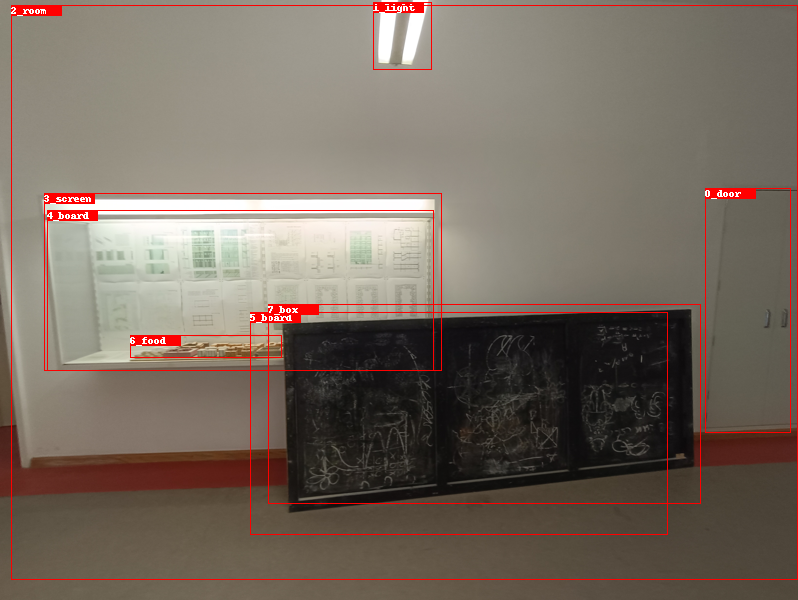

**************************************************
box_labels 0: door; score: 0.7808620929718018
box_labels 1: light; score: 0.5272099375724792
box_labels 2: room; score: 0.1831132024526596
box_labels 3: screen; score: 0.08381522446870804
box_labels 4: board; score: 0.08378507941961288
box_labels 5: board; score: 0.06909056007862091
box_labels 6: food; score: 0.0572550967335701
box_labels 7: box; score: 0.056985653936862946
**************************************************
rel_labels 0: 2_room => has => 0_door; score: 0.8840078711509705
rel_labels 1: 5_board => in => 2_room; score: 0.7199296951293945
rel_labels 2: 1_light => above => 5_board; score: 0.6770145297050476
rel_labels 3: 2_room => has => 1_light; score: 0.6342868804931641
rel_labels 4: 1_light => above => 7_box; score: 0.6326671838760376
rel_labels 5: 4_board => in => 2_room; score: 0.6264885663986206
rel_labels 6: 2_room => has => 3_screen; score: 0.6208674907684326
rel_labels 7: 7_box => in => 2_room; score: 0.60553056001

In [21]:
for image_idx in range(len(custom_data_info['idx_to_files'])):

    image_path = custom_data_info['idx_to_files'][image_idx]
    boxes = custom_prediction[str(image_idx)]['bbox'][:box_topk]
    box_labels = custom_prediction[str(image_idx)]['bbox_labels'][:box_topk]
    box_scores = custom_prediction[str(image_idx)]['bbox_scores'][:box_topk]
    all_rel_labels = custom_prediction[str(image_idx)]['rel_labels']
    all_rel_scores = custom_prediction[str(image_idx)]['rel_scores']
    all_rel_pairs = custom_prediction[str(image_idx)]['rel_pairs']

    for i in range(len(box_labels)):
        box_labels[i] = ind_to_classes[box_labels[i]]

    rel_labels = []
    rel_scores = []
    for i in range(len(all_rel_pairs)):
        if all_rel_pairs[i][0] < box_topk and all_rel_pairs[i][1] < box_topk:
            rel_scores.append(all_rel_scores[i])
            label = str(all_rel_pairs[i][0]) + '_' + box_labels[all_rel_pairs[i][0]] + ' => ' + ind_to_predicates[all_rel_labels[i]] + ' => ' + str(all_rel_pairs[i][1]) + '_' + box_labels[all_rel_pairs[i][1]]
            rel_labels.append(label)

    rel_labels = rel_labels[:rel_topk]
    rel_scores = rel_scores[:rel_topk]

    draw_image(image_path, boxes, box_labels, rel_labels, box_scores=box_scores, rel_scores=rel_scores, save=True)

[0.5, 0.8, 0.3, 0.9, 0.6]
[1.2, 0.4, 0.9, 0.7, 0.5]
[10, 20, 30, 40, 50]
